## Part 3: EDA + Data Visualisation 


### Packages and Settings

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import pandas_profiling
import seaborn as sns
import numpy as np
import plotly.express as px
sns.set_style("darkgrid")


%config InlineBackend.figure_format = 'retina'
%matplotlib inline

### Progress Report Aims: 

#### Exploratory analysis of the dataset to include:


* Distribution of brands 
* Density of all handbags in the dataset
* Distribution of prices among models of each brand
* Most/least popular handbags
* Insights between sold and available handbags 
* Best colors for long-term investmest
* The most valuable materials
* Impact of the bag being limited edition 
* Average Retail Price vs Secondary Market Price
* Heatmap to review correlation between variables
* Return current Resale Prices Function
* Word importance for sale in Descriptions for Chanel and Hermes brands / WordCloud

### Data Loading

In [2]:
# Read and show first 5 rows and last 5 rows of the dataset
handbags = pd.read_csv('cleaned_data_handbags.csv')
handbags

,brand,title,price,final_resale_price,n_likes,limited,model,condition,m_model,material,color,sold_out,description,mean_retail_price
0,Louis Vuitton,Pochette Accessoire cloth clutch bag,1080.00,776.00,53.0,1,pochette,Never worn,Pochette Accessoire,Cloth,Brown,1.0,NaN,660.0
1,Louis Vuitton,Pochette Accessoire cloth clutch bag,495.00,495.00,42.0,1,pochette,Never worn,Pochette Accessoire,Cloth,Brown,1.0,NaN,660.0
2,Louis Vuitton,Speedy cloth handbag,1480.00,1480.00,52.0,1,speedy,Never worn,Speedy,Cloth,Pink,1.0,NaN,1790.0
3,Louis Vuitton,Speedy cloth handbag,1880.00,1880.00,59.0,1,speedy,Very good condition,Speedy,Cloth,White,1.0,NaN,1790.0
4,Louis Vuitton,Speedy cloth handbag,1850.00,1680.00,60.0,1,speedy,Very good condition,Speedy,Cloth,Red,1.0,NaN,1790.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12769,Hermès,Birkin 35 leather handbag,13783.90,13783.90,25.0,0,birkin,"Never worn, with tag",Birkin 35,Leather,Blue,1.0,HERMES BIRKIN 35 EPSOM NORTH BLUE GHDW. New ne...,7700.0
12770,Hermès,Birkin 35 leather handbag,14296.80,14296.80,38.0,0,birkin,"Never worn, with tag",Birkin 35,Leather,Multicolour,1.0,Incredible limited edition Birkin 35 bicolor b...,7700.0
12771,Hermès,Birkin 25 leather handbag,12330.99,10445.60,78.0,0,birkin,Very good condition,Birkin 25,Leather,Red,1.0,"Hermès Birkin 25 geranium color, togo leather,...",6490.0
12772,Hermès,Birkin 35 leather handbag,5986.79,4512.43,26.0,0,birkin,Good condition,Birkin 35,Leather,Black,1.0,Bag in good general condition missing the padl...,7700.0


In [50]:
print(handbags.shape,'\n')
handbags.info()

(12774, 14) 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12774 entries, 0 to 12773
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   brand               12774 non-null  object 
 1   title               12774 non-null  object 
 2   price               12774 non-null  float64
 3   final_resale_price  12774 non-null  float64
 4   n_likes             12774 non-null  float64
 5   limited             12774 non-null  int64  
 6   model               12774 non-null  object 
 7   condition           12774 non-null  object 
 8   m_model             12774 non-null  object 
 9   material            12774 non-null  object 
 10  color               12774 non-null  object 
 11  sold_out            12774 non-null  float64
 12  description         5122 non-null   object 
 13  mean_retail_price   12774 non-null  float64
dtypes: float64(5), int64(1), object(8)
memory usage: 1.4+ MB


In [47]:
handbags.describe()

,price,final_resale_price,n_likes,limited,sold_out,mean_retail_price
count,12774.000000,12774.000000,12774.000000,12774.000000,12774.000000,12774.000000
mean,4371.371295,3986.566318,40.194066,0.098716,0.465868,3859.692892
std,6816.628383,6234.092414,54.152679,0.298292,0.498853,4288.783749
min,200.000000,200.000000,0.000000,0.000000,0.000000,440.000000
25%,823.282500,742.720000,10.000000,0.000000,0.000000,1070.000000
50%,2233.880000,1980.055000,23.000000,0.000000,0.000000,1790.000000
75%,4860.910000,4467.750000,49.000000,0.000000,1.000000,5800.000000
max,196581.000000,146958.590000,1228.000000,1.000000,1.000000,28900.000000


### Distribution of data by brands 

At the pair plots below, we can observe nice linear relationship between price and discount_price, which is reasonable.
The highest resale prices has Hermes brand. Louis Vuitton is the best selling hangbags , where as Hermes has the lowest amount of sales.

The most expensive handbag that was sold on Vestiare Collective website was under £50,000 for one of the Hermes bags. 
The most favorable bags are not the most expensive ones. For instance handbags under £5,000 retail price has the biggest number of likes from customers .

/Users/Ketevana/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/Users/Ketevana/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.



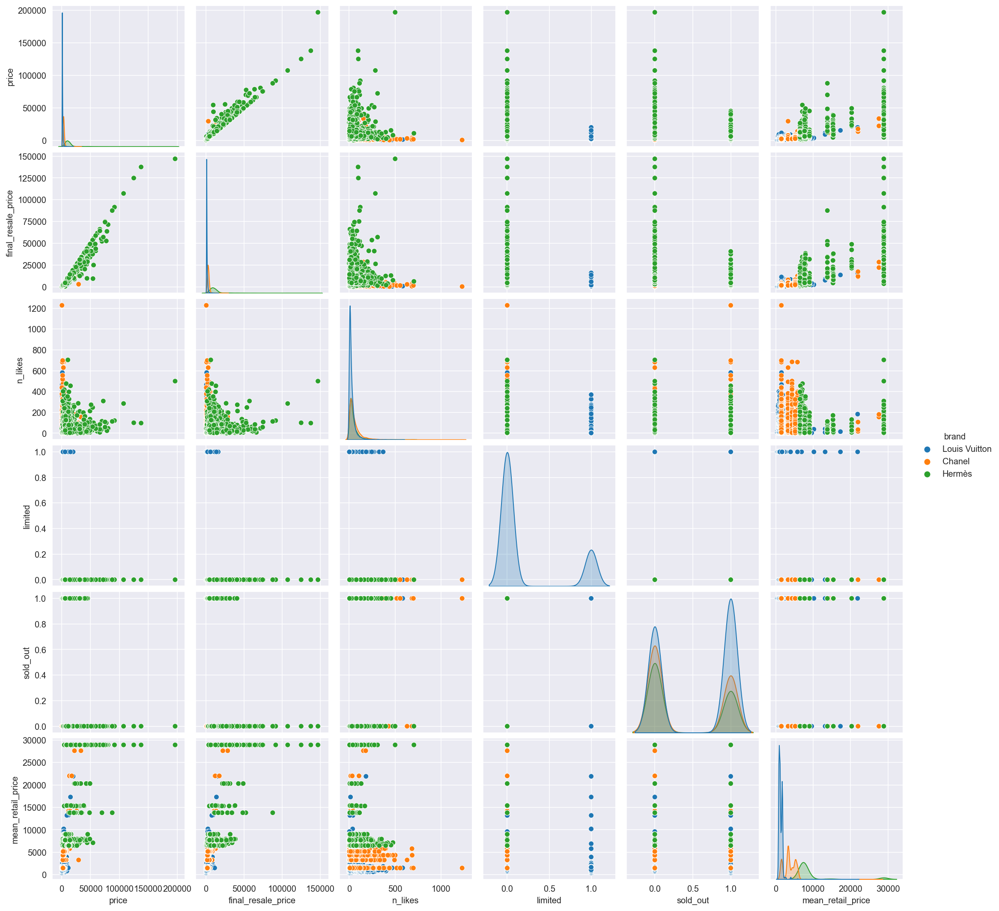

In [385]:
# Plotting pairplot to look at pairwise bivariate distributions in a dataset
sns.pairplot(handbags, hue="brand")
plt.show()

### Density of all handbags in the dataset

The graph below represent the Kernel Density Estimation which is a non-parametric method of estimating the probability density function of a continuous random variable (in this case Resale Price) and the plots are a way of encoding the density of observations. 

The highest density has Louis Vuitton Pochette model handbag with one of the lowest resale price, under £1,000. At the same time: Speedy, Alma and Neverfull handbags of same brand (LV) ranked with highest density and lowest in price compared to other bags.

The lowest density is observed in models such as Kelly and Birkin, Keepall and Capucines for Hermes and Louis Vuitton brands respectively. Moreover, these models have the widest distribution in prices . Capucines and Keepall price raise up to £13,000, whereas the density for Birkin and Kelly models just got its peak at this number. Kelly and Birkin models price goes beyond £25,000 with lower density and price up to £205,000 for Birkin handbag.

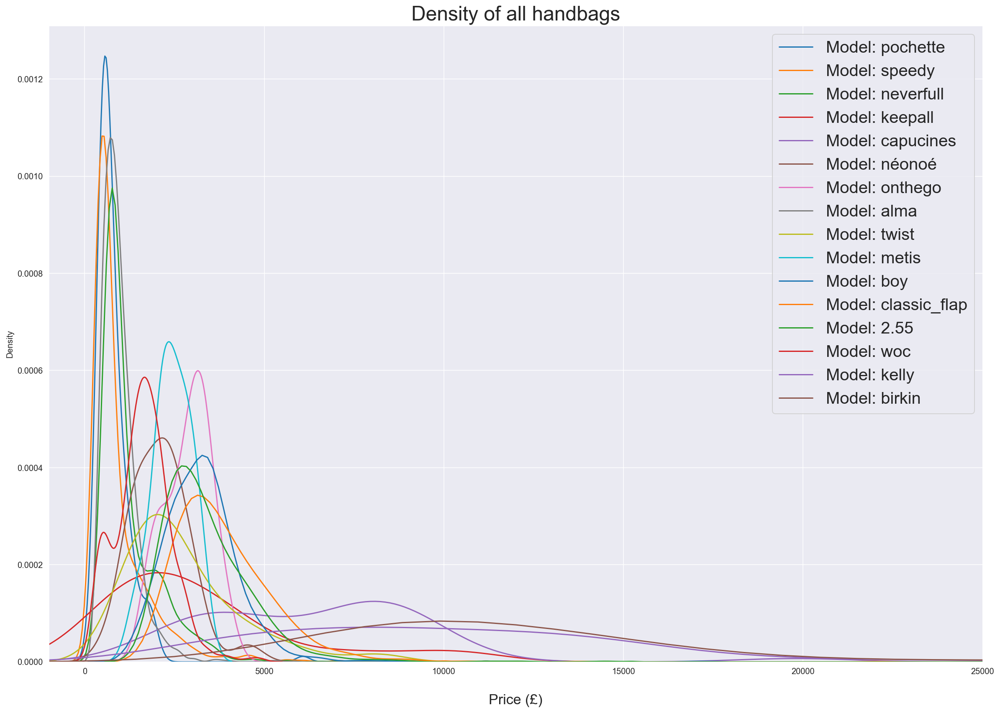

In [386]:
# Kernel Density Estimation plot , closer look at handbags density with limit on x axes until 25,000 (Price £)

plt.figure(figsize=(20, 14))
for model in handbags['model'].unique():
    sns.kdeplot(handbags[handbags['model'] == model]['price'], label='Model: '+ model)

plt.xlim(-1000, 25000)
plt.legend(fontsize=20)
plt.xlabel('\nPrice (£)', fontsize=17)
plt.title('Density of all handbags', fontsize=24)
plt.show()

### Distribution of final prices among models for each brand

The boxplots display the distribution of prices for Louis Vuitton brand's models. 
We see that the highest number of outliers has Speedy, Neverfull and Alma models. In addition, are also single outliers at Pochette, Keepall, Capucines and Twist models. 

What's most surprising about this graph is that the Capucines handbags has the widest price distribution, ranging from £2,000 to £9,000 with an outlier cost of £16,000. 

Consequently, other Louis Vuitton handbags have 75% price distribution below £2,500 - £3,000.


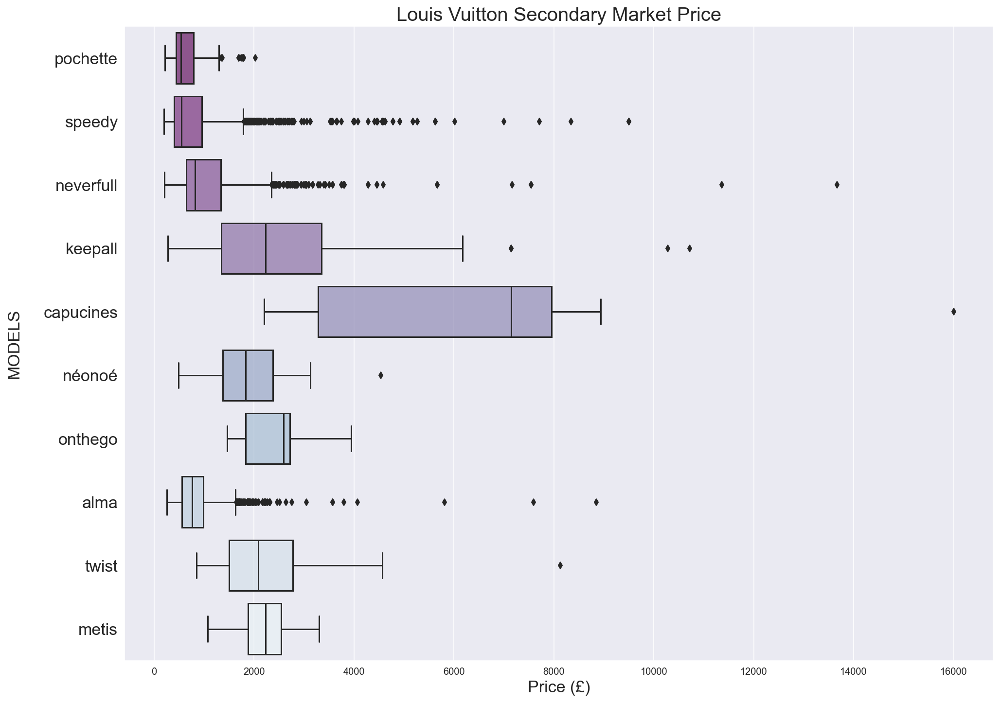

In [387]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 12))

# usual boxplot, plotted on a matplotlib.axes object named ax
ax = sns.boxplot(x=handbags.final_resale_price, y=handbags[handbags['brand'] == 'Louis Vuitton']['model'], orient = 'h', 
            palette="BuPu_r")

# Plot LV models vs Prices
ax.set_title('Louis Vuitton Secondary Market Price', fontsize=20)
ax.set_ylabel('MODELS\n', fontsize=17)
ax.set_xlabel('Price (£)\n', fontsize=17)
ax.set_yticklabels(ax.yaxis.get_ticklabels(), fontsize=17)
 
# adding transparency to colors
for patch in ax.artists:
    r, g, b, a = patch.get_facecolor()
    patch.set_facecolor((r, g, b, .7))

plt.show()

#### Chanel category final resale price distribution

The distribution of prices in Chanel category is more or less evenly across all models. Each model contains approximately equal amount of outliers, and the highest of them is in the classic flap and boy models, over £28,000 and £17,000 respectively.

Futhermore, 75% of resale price distribution among all Chanel models are under £5,000. The lowest cost has WOC with a price distribution up to 4000 (with outliers up to £5,000), but for instance 75% of WOC observations is under £2,000.


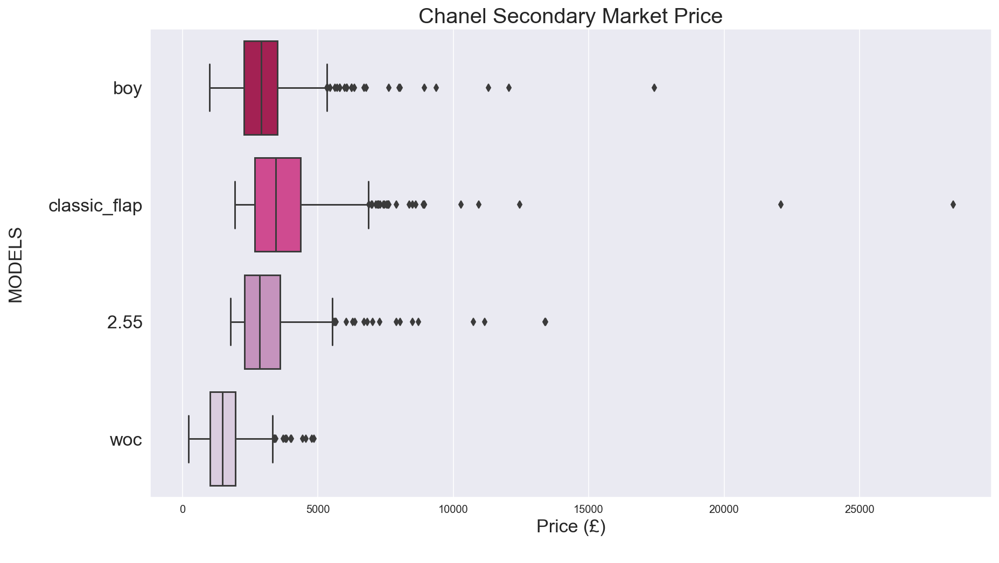

In [388]:
# Plot Chanel models vs Prices
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14, 8)) 

sns.boxplot(x=handbags.final_resale_price, y=handbags[handbags['brand'] == 'Chanel']['model'], palette="PuRd_r")

ax.set_title('Chanel Secondary Market Price', fontsize=20)
ax.set_ylabel('MODELS\n', fontsize=17)
ax.set_xlabel('Price (£)\n', fontsize=17)
ax.set_yticklabels(ax.yaxis.get_ticklabels(), fontsize=17)
 
plt.show()

#### Hermes category final resale price distribution

The distribution of prices in Hermes category is also about the same. We clearly see a higher number of outliers in  Birkin model, almost twice as it is in the Kelly model. The final price of the biggest Birkin outlier goes over £146,000, whereas Kelly's biggest outlier is around £107,000.

In addition, 90% of resale price distribution among Kelly and Birkin models are under £20,000. The median of both median is around £9,000-£10,000. 

The most lowest resale price has Kelly bag which is 10 times less than the lowest price of final Birkin handbag.

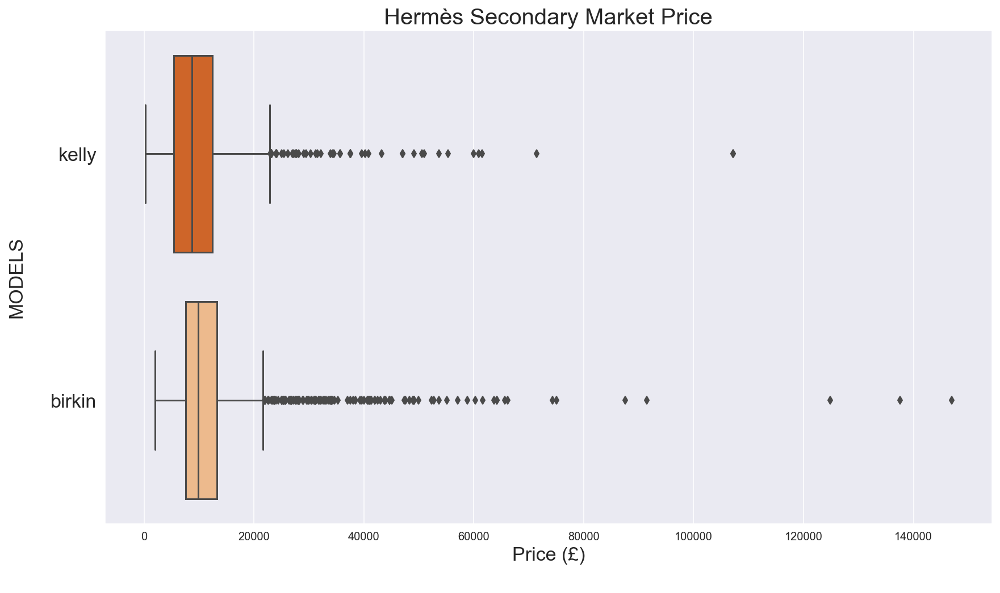

In [389]:
# Plot Hermes models vs Prices
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14, 8)) 

sns.boxplot(x=handbags.final_resale_price, y=handbags[handbags['brand'] == 'Hermès']['model'], palette="Oranges_r")

ax.set_title('Hermès Secondary Market Price', fontsize=20)
ax.set_ylabel('MODELS\n', fontsize=17)
ax.set_xlabel('Price (£)\n', fontsize=17)
ax.set_yticklabels(ax.yaxis.get_ticklabels(), fontsize=17)
 
plt.show()

In [390]:
# Main statisticts of the final resale price for Kelly and Birkin handbags

display('Kelly',handbags[handbags.model == 'kelly']['final_resale_price'].describe()),'\n'
display('Birkin',handbags[handbags.model == 'birkin']['final_resale_price'].describe())

'Kelly'

count      1441.000000
mean       9891.350645
std        7755.514899
min         200.990000
25%        5384.760000
50%        8667.440000
75%       12420.350000
max      107226.000000
Name: final_resale_price, dtype: float64

'Birkin'

count      1604.000000
mean      12433.291708
std       10421.039141
min        1977.430000
25%        7595.180000
50%        9901.470000
75%       13253.230000
max      146958.590000
Name: final_resale_price, dtype: float64

### ROI function

In [430]:
def ROI(df, brand, model):
    """ 
    Function: takes a dataframe, brand name and model name, to generate 
    mean Return on investment of sold items per each model of the brand, and an approximate
    estimation of mean Return on investment of unsold handbags on secondary market platform.
    
    """
    net_return = df.loc[(df.brand == brand) 
                              & (df.model == model)].groupby('sold_out')["final_resale_price"].mean()[1]

    initial_value = df.loc[(df.brand == brand) 
                              & (df.model == model)]["mean_retail_price"].values.mean()
    
    net_return_unsold = df.loc[(df.brand == brand) 
                              & (df.model == model) & (df.sold_out == 0)]["final_resale_price"].mean()

    initial_value_unsold = df.loc[(df.brand == brand) 
                                  & (df.model == model) & (df.sold_out == 0)]["mean_retail_price"].values.mean()
 
    
    if brand == 'Hermès':
        net_return = df.loc[(df.brand == brand) & (df.m_model == model)] \
        .groupby('sold_out')["final_resale_price"].mean()[1]
        
        initial_value = df.loc[(df.brand == brand) & (df.m_model == model)]["mean_retail_price"].values.mean()
        
        net_return_unsold = df.loc[(df.brand == brand) & (df.m_model == model) & (df.sold_out == 0)]["final_resale_price"].mean()
        
        initial_value_unsold = df.loc[(df.brand == brand) & (df.m_model == model) & (df.sold_out == 0)]["mean_retail_price"].values.mean()
    
    
    potential_ROI = round(((net_return_unsold - initial_value_unsold) / initial_value_unsold) * 100, 1)
    ROI = round(((net_return - initial_value) / initial_value) * 100, 1)
    
    return print('\nThe Return on investment of {} model of {} handbag is {}%\n' \
                 '\nPotential Return on investment of unsold {} handbag is: {}%'
                 .format(model, brand, ROI, model, potential_ROI))
        

ROI(handbags, 'Chanel', 'boy')


The Return on investment of boy model of Chanel handbag is -27.9%

Potential Return on investment of unsold boy handbag is: -3.9%


### Best colors for long-term investmest
### The most valuable materials
### The best value models and their conditions 
### Insights between sold and unsold handbags 


#### Louis Vuitton
 
Capucines and Keepall are the best performing models with returns on investment of 31.7% and 59.6% respectively. 
They are both limited edition and the data indicates that they sell quickly for price higher than the original purchae price. 

Louis Vuitton exotic leathers are not a great investment as they lose their value over time, whereas unique materials such metals, fur, plastic raise in value. Surprisingly, suede and patent leather are the worse performing materials from an investment perspective as they lose value following purchase. 

The best performing colours are gold, beige, multicolour, anthracite and silver.
Turquoise and grey are the worst performing. 


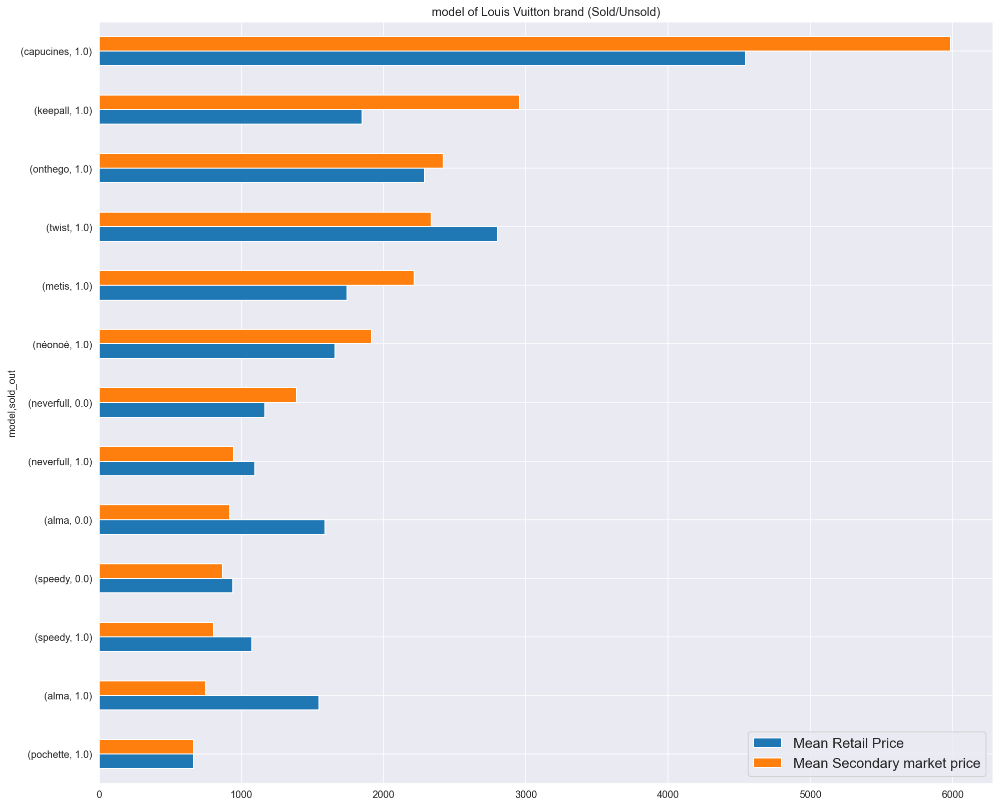

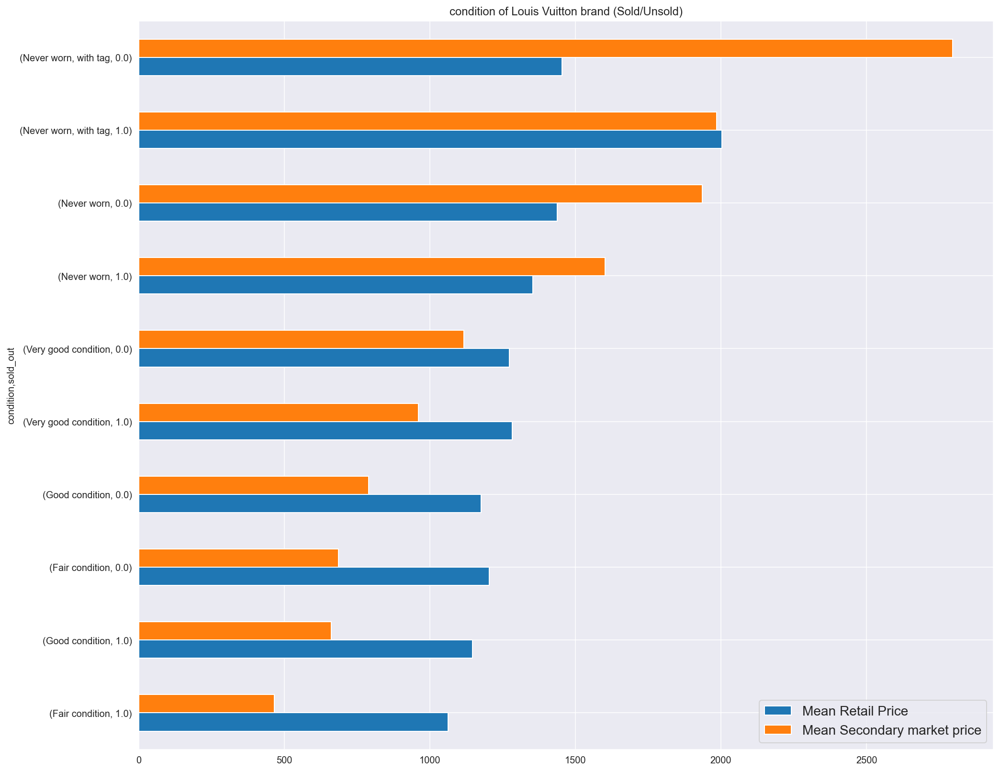

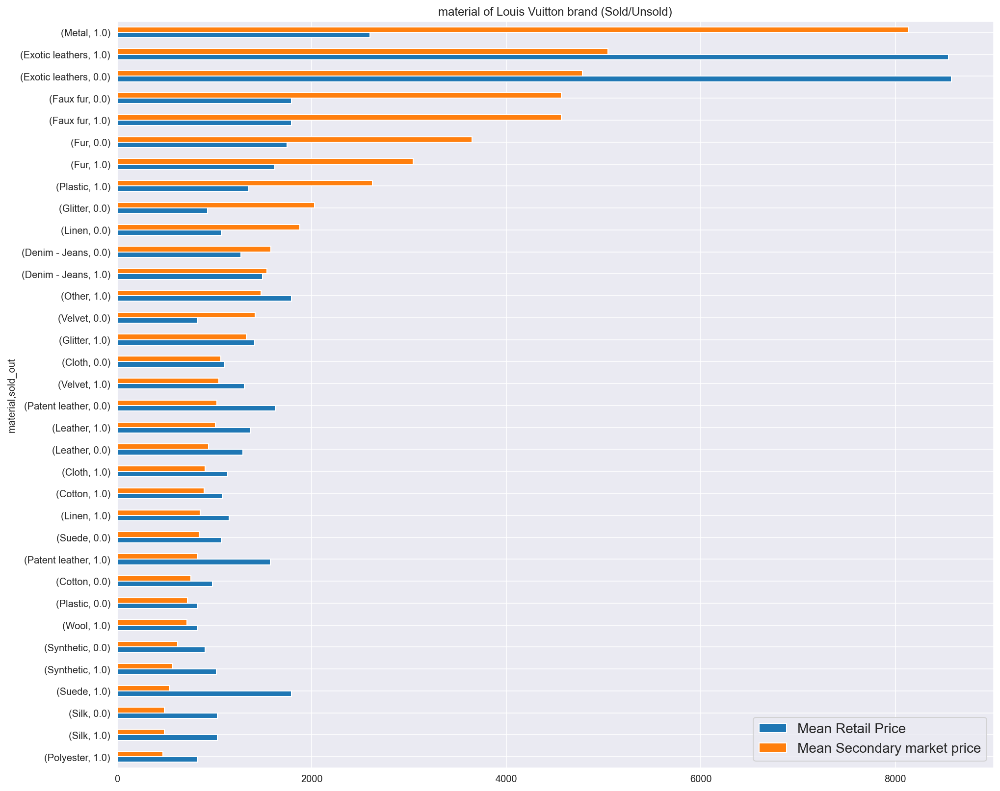

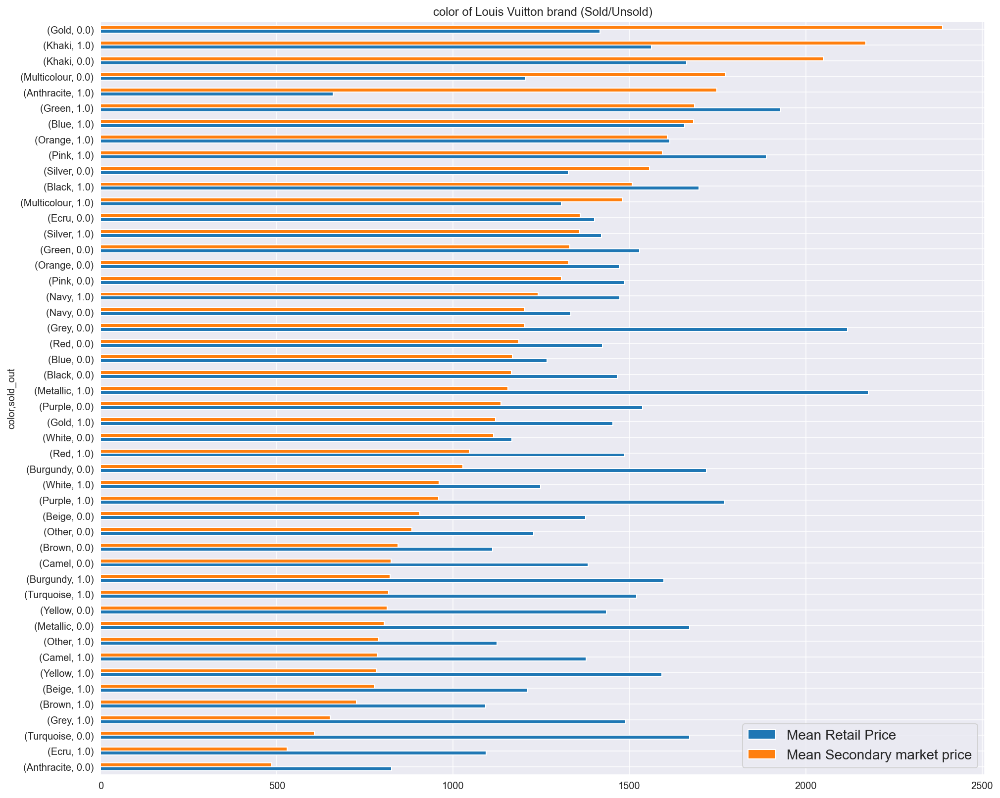

In [455]:
# Plot bar charts of categorical features across LV brand grouped by Sold(1) and Unsold items(0), 
# representing the difference between mean Retail price and mean Final Resale price 

for x in handbags.describe(include='object').columns:
    if x != 'description' and x != 'title' and x != 'brand' and x != 'm_model':
         handbags[handbags.brand == 'Louis Vuitton'].groupby([x, 'sold_out'])[["mean_retail_price", "final_resale_price"]] \
        .mean().sort_values(by='final_resale_price').plot(kind='barh', figsize=(16, 14), 
        title=x+" of Louis Vuitton brand (Sold/Unsold)").legend(['Mean Retail Price', 'Mean Secondary market price'],
                                                                prop={'size': 14})
          
        

Surprisingly, the return of investment for channel are quite poor relative to other brands. Wallet on chain has a marginally positive return (22.7% potential/ -19.7% sold) with all other models with negative returns. Boy model roughly holds its value.  2.55 model has the worst return with a negative return on investment of -45.1%


Unsurprisngly, never warn and never warn with tags generate the highest returns. 

Calfskin is the only material which generates positive returns, most chanel bags are made of calfskin.  The worst performing are symthetics, polyester and plastic. 

All colours generate negative returns, with anthracite and ecru being the worst performers. 

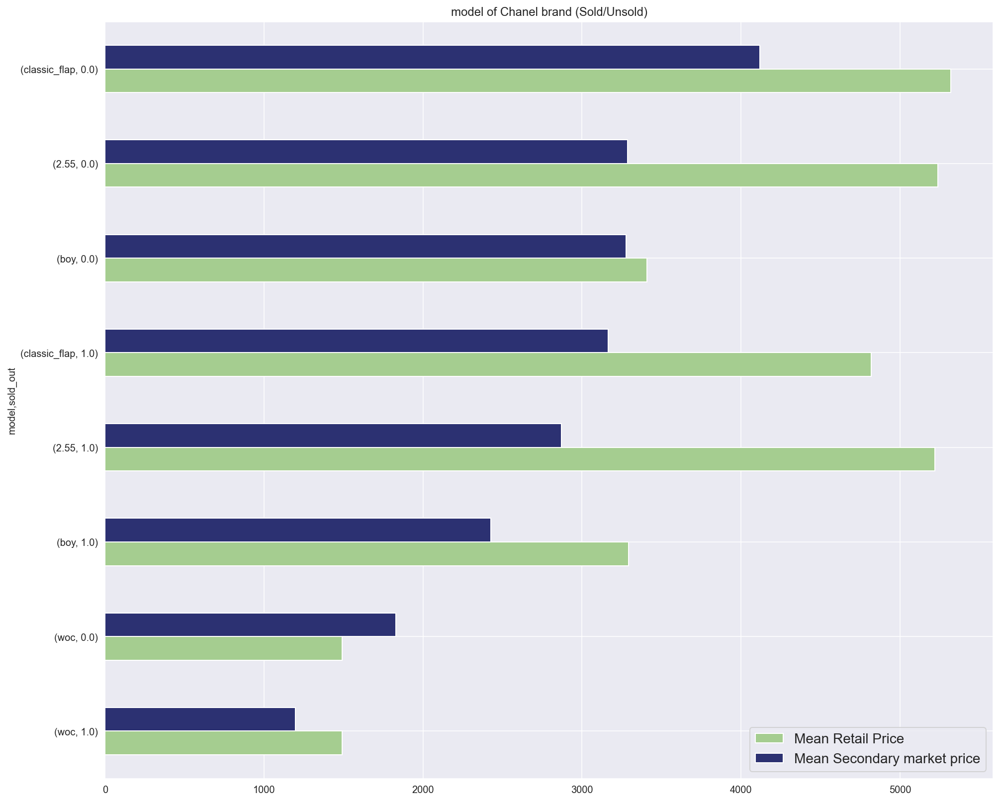

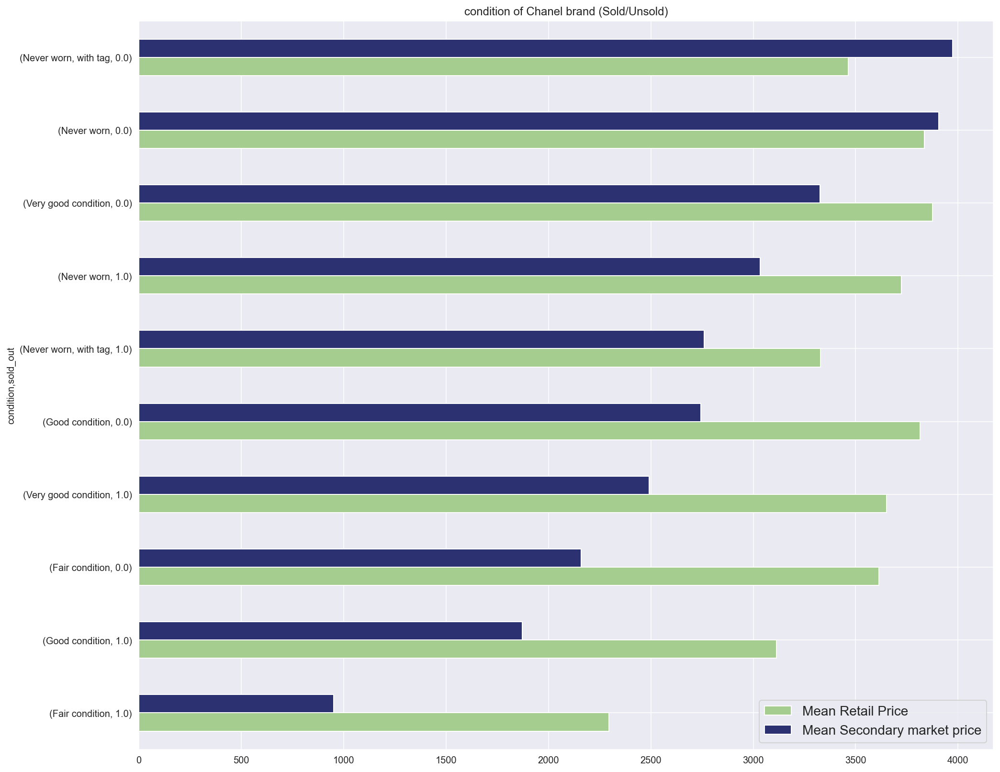

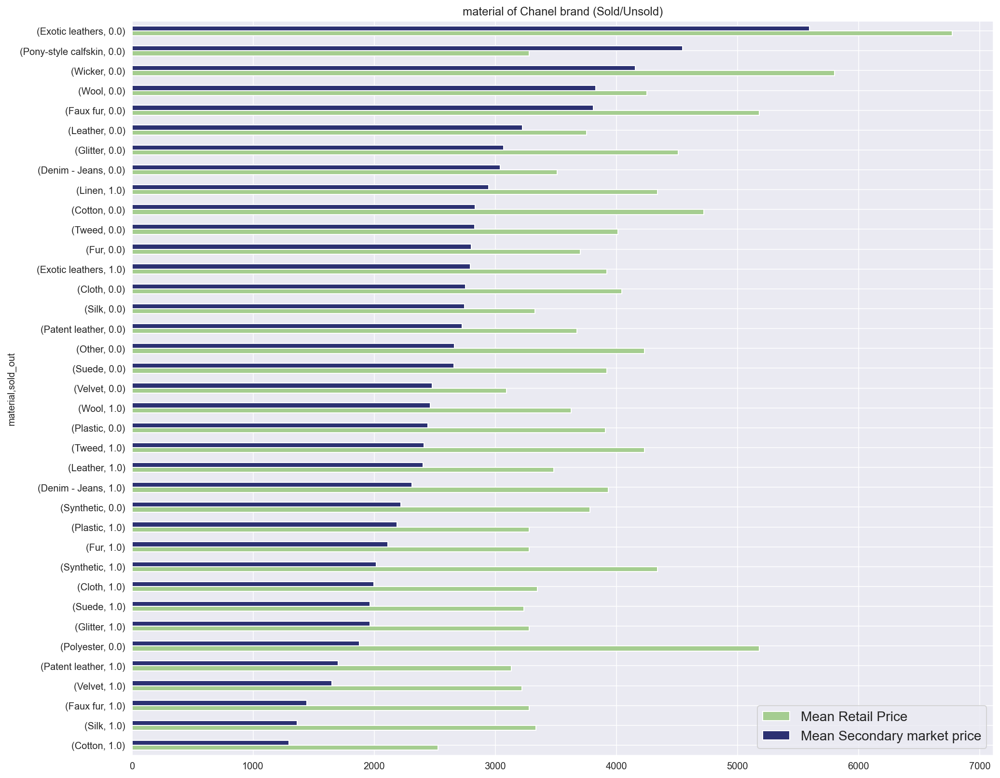

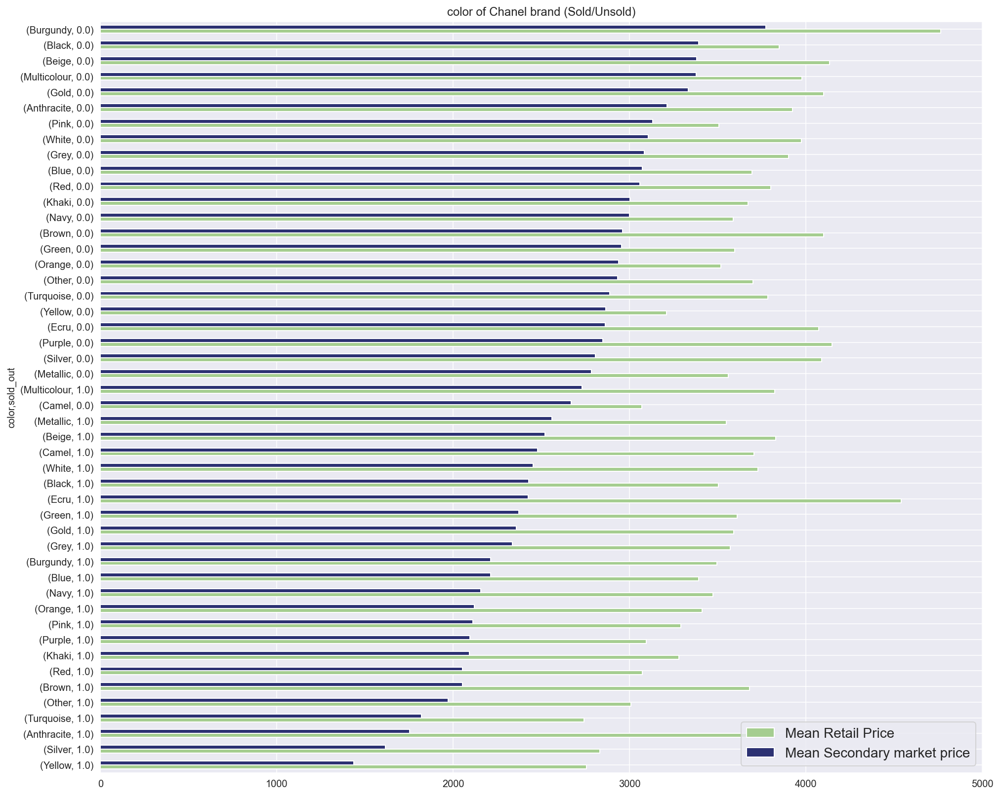

In [456]:
# Plot bar charts of categorical features across Chanel brand grouped by Sold(1) and Unsold items(0), 
# representing the difference between mean Retail price and mean Final Resale price 

for x in handbags.describe(include='object').columns:
    if x != 'description' and x != 'title' and x != 'brand' and x != 'm_model':
        handbags[handbags.brand == 'Chanel'].groupby([x, 'sold_out'])[["mean_retail_price", "final_resale_price"]] \
        .mean().sort_values(by='final_resale_price').plot(kind='barh', figsize=(16, 14), 
         title=x+" of Chanel brand (Sold/Unsold)", cmap="crest").legend(['Mean Retail Price', 'Mean Secondary market price'],
                                                                prop={'size': 14})
        

As with the other brands, never warn or brand new generate the best returns.  With Hermes, however, very good condition also generates positive returns. 

Smaller models appear to be better investments, with Birkin 25 and Kelly 25 leading the way. 
Kelly 35 is the worst performing models

Suede, cottons and exotic leathers are the best performing materials.   Plastics are the are worst

White, yellow, green are the best colour choices for returns, with white leading the way.
Anthracite generates the worst returns. 

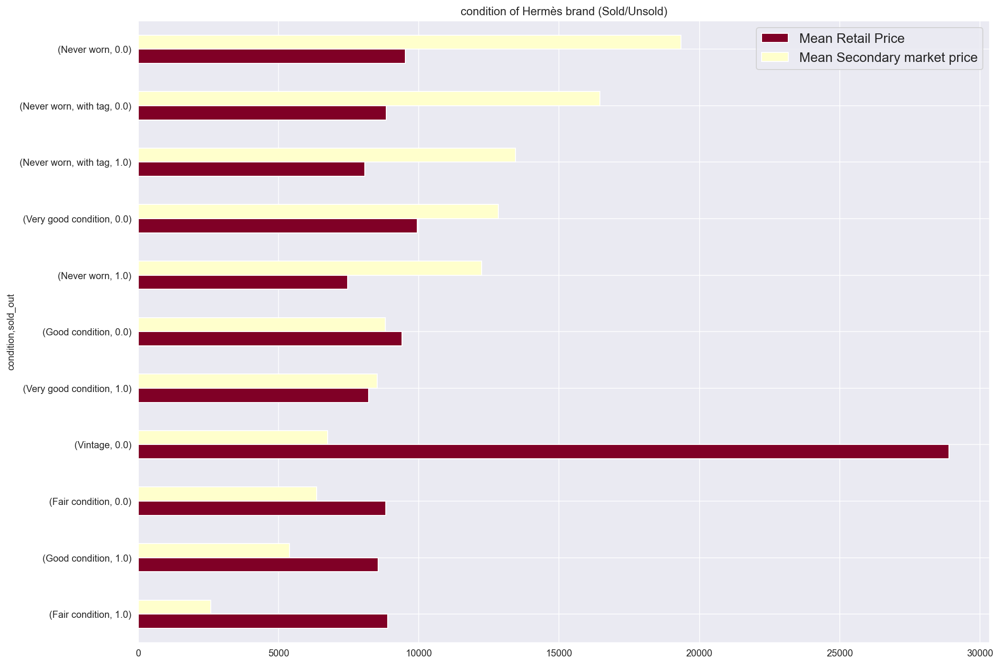

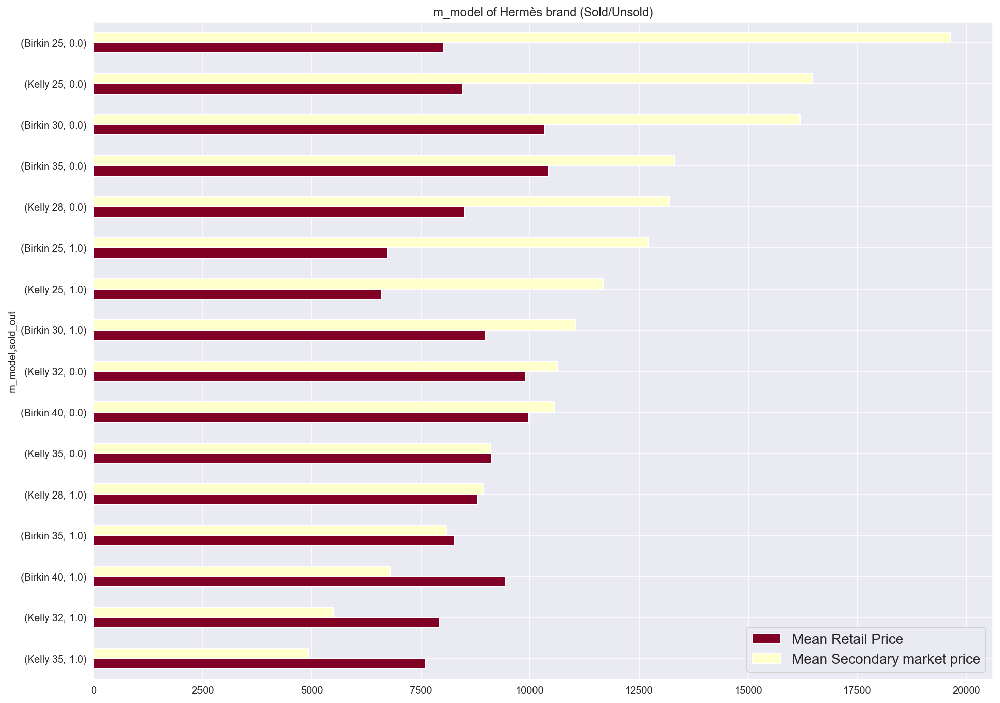

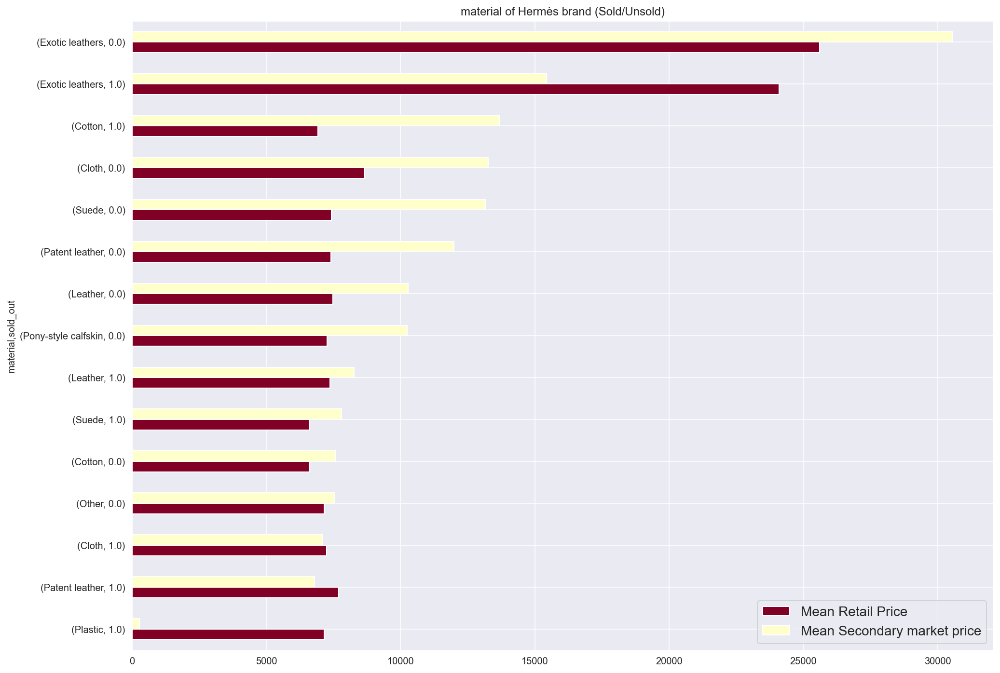

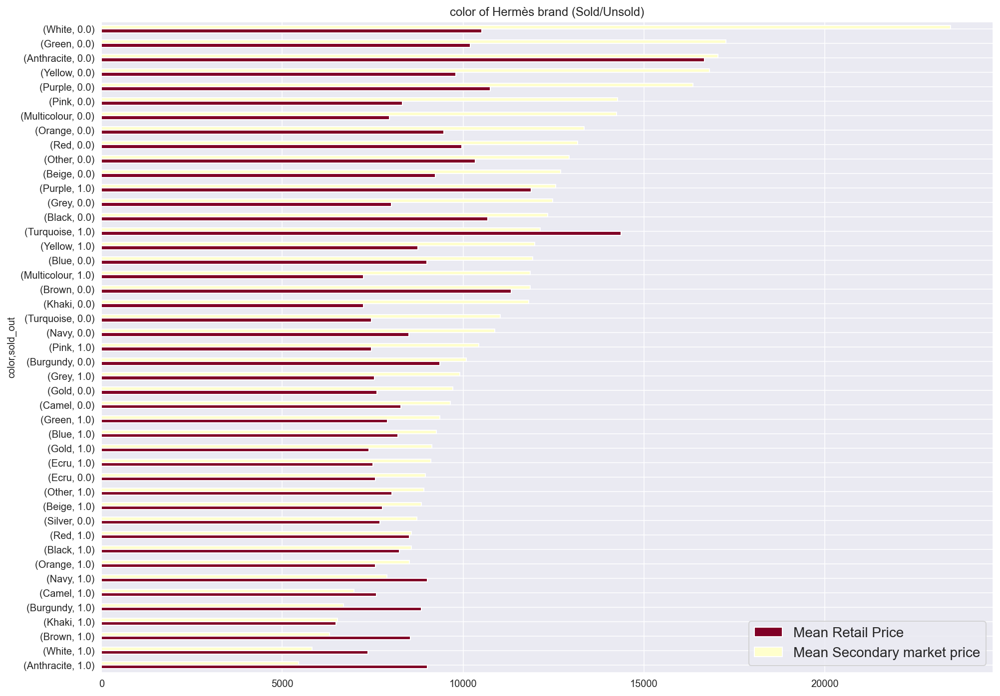

In [457]:
# Plot bar charts of categorical features across Hermes brand grouped by Sold(1) and Unsold items(0), 
# representing the difference between mean Retail price and mean Final Resale price 


for x in handbags.describe(include='object').columns:
    if x != 'description' and x != 'title' and x != 'brand' and x != 'model':
        handbags[handbags.brand == 'Hermès'].groupby([x, 'sold_out'])[["mean_retail_price", "final_resale_price"]] \
        .mean().sort_values(by='final_resale_price').plot(kind='barh', figsize=(16, 12), 
         title=x+" of Hermès brand (Sold/Unsold)", cmap="YlOrRd_r", ).legend(['Mean Retail Price', 'Mean Secondary market price'],
                                                                prop={'size': 14})

    

In [3]:
fig = px.scatter_matrix(handbags, dimensions=["mean_retail_price", "final_resale_price", "model", "color", "material"],
                        color="sold_out", )
fig.show()

In [396]:
handbags[handbags.condition == 'Vintage']

,brand,title,price,final_resale_price,n_likes,limited,model,condition,m_model,material,color,sold_out,description,mean_retail_price
9836,Hermès,Kelly 32 crocodile handbag,7952.6,6755.24,161.0,0,kelly,Vintage,Kelly 32,Exotic leathers,Brown,0.0,Havana Crocodilus porosus Kelly 32. Vintage fr...,28900.0
10366,Hermès,Kelly 32 crocodile handbag,7952.6,6755.24,162.0,0,kelly,Vintage,Kelly 32,Exotic leathers,Brown,0.0,Havana Crocodilus porosus Kelly 32. Vintage fr...,28900.0


In [397]:
handbags[handbags.material == 'Metal']

,brand,title,price,final_resale_price,n_likes,limited,model,condition,m_model,material,color,sold_out,description,mean_retail_price
211,Louis Vuitton,Twist handbag,8134.76,8129.86,17.0,1,twist,Very good condition,Twist,Metal,Black,1.0,NaN,2600.0


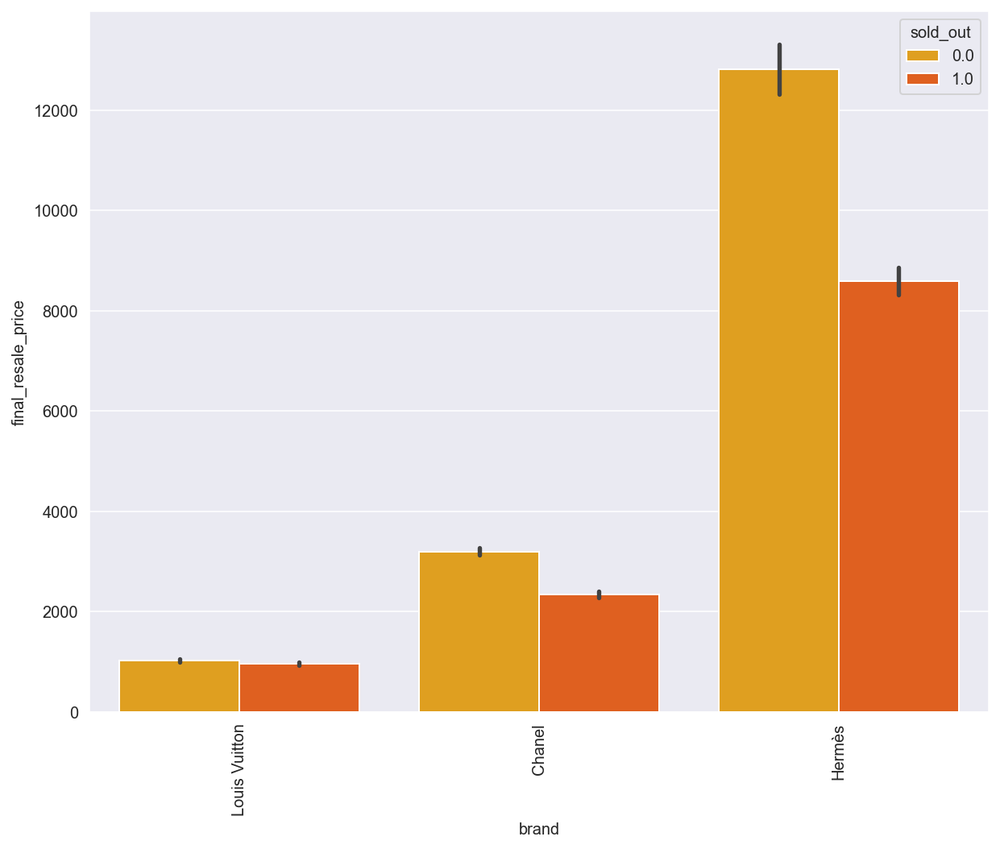

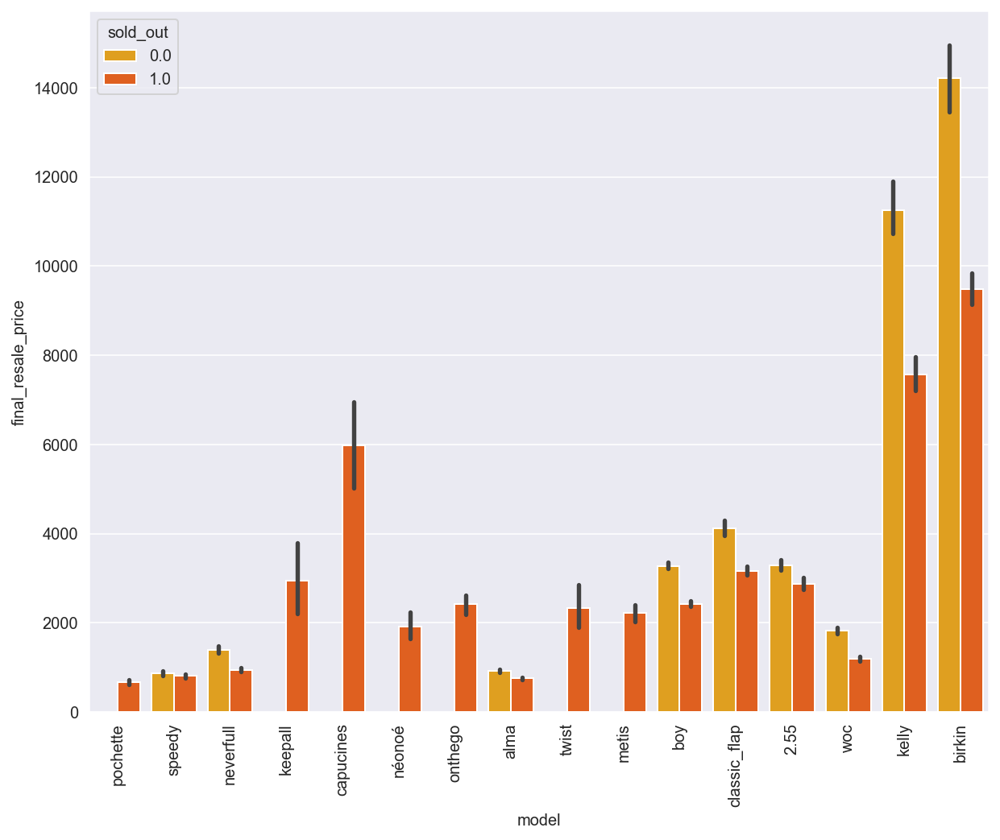

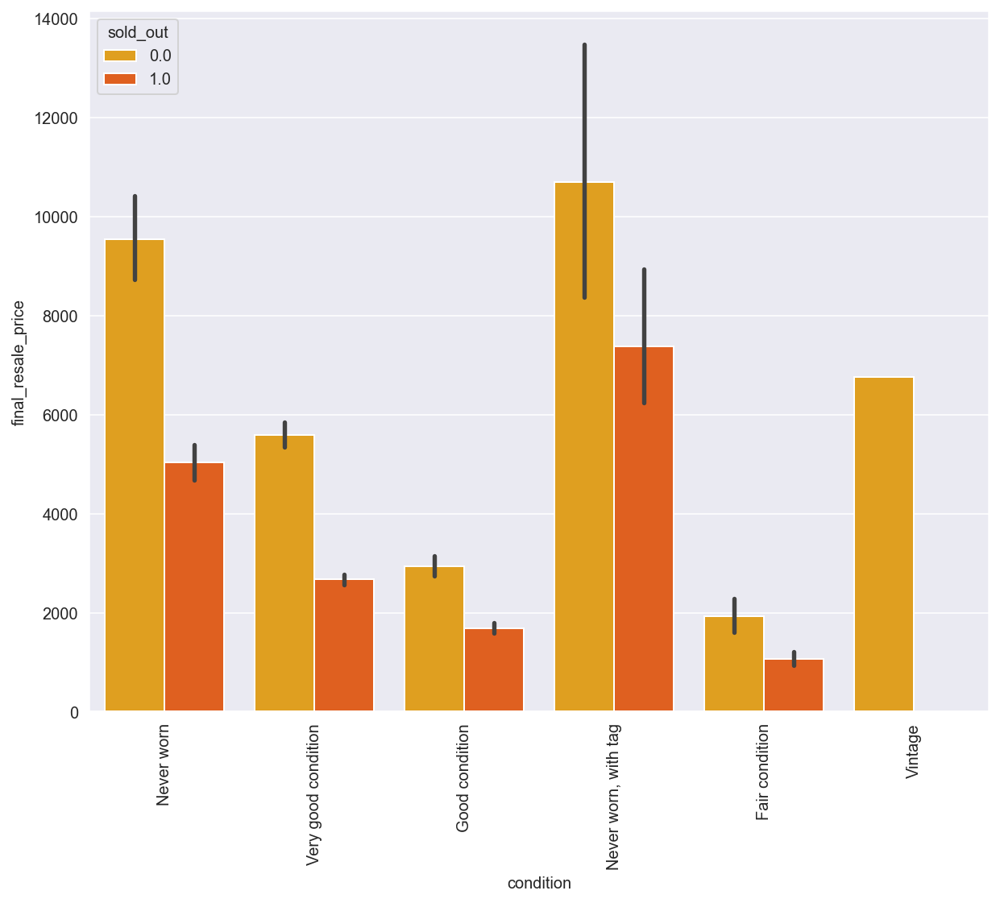

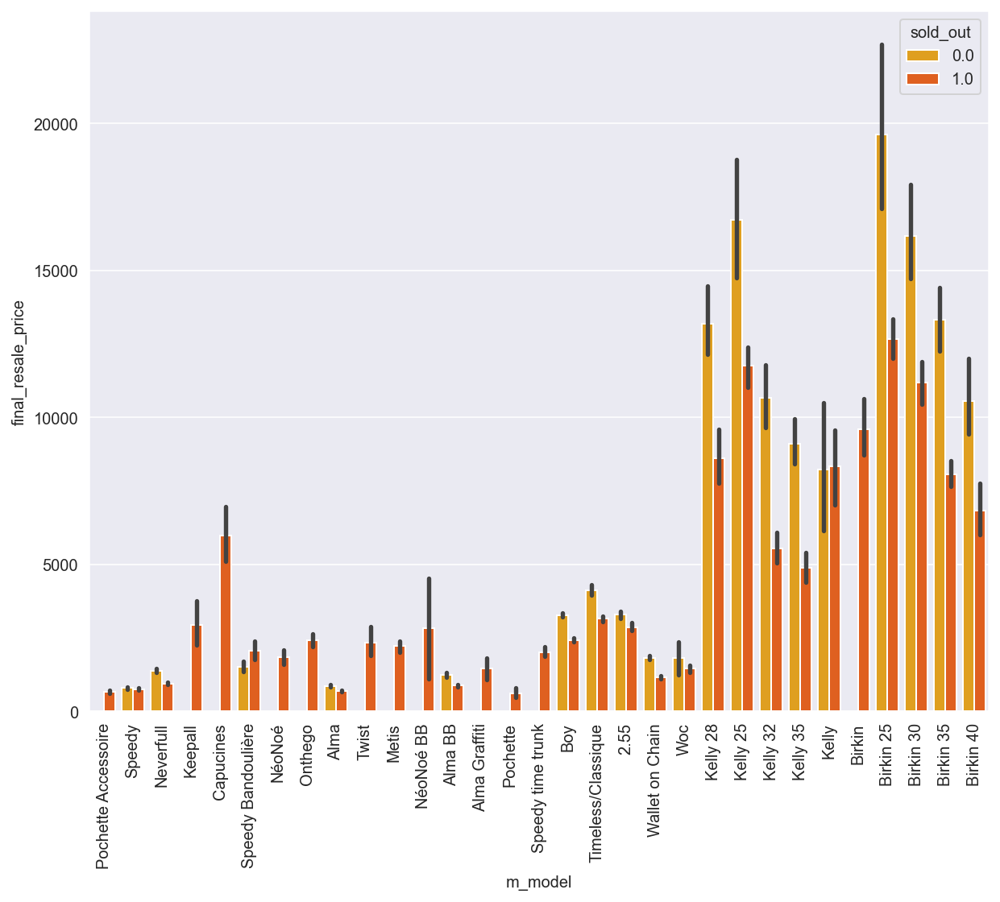

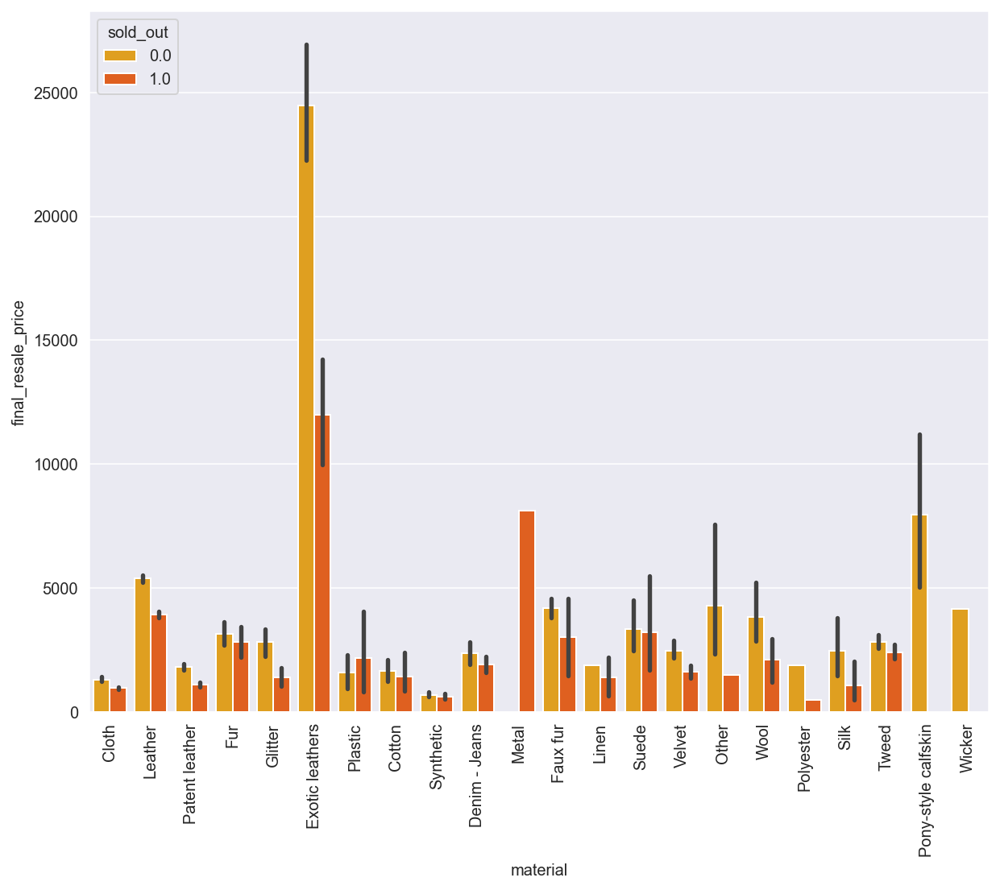

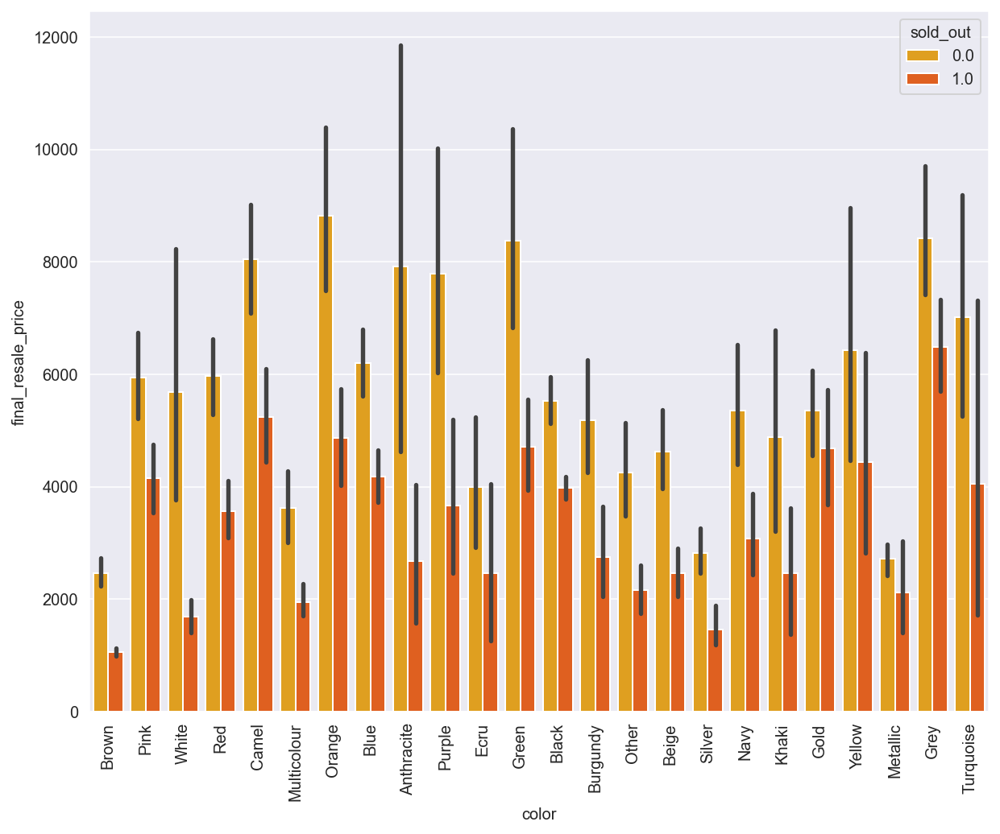

In [398]:
# Bar plots of mean values across all brands and all categorical features

for x in handbags.describe(include='object').columns:
    if x != 'description' and x != 'title':
        plt.figure(figsize= (10, 8))
        sns.barplot(x=handbags[x], y = handbags.final_resale_price, hue=handbags.sold_out, palette="autumn_r" )
        plt.xticks(rotation=90)

### Most/least popular handbags

More favourable turns out Chanel handbags, models such as classic flap and woc are leading , whereas speedy has the least number of like per bag.

The vintage condition is gaining a fairly high number of likes in comparison with other categories, along with silk ,  preference is given to Denim and Tweed materials because it is quite unusual and unique materials of handbags. 
In terms of color , the most favorite are Turquoise , Black and Navy color bags.

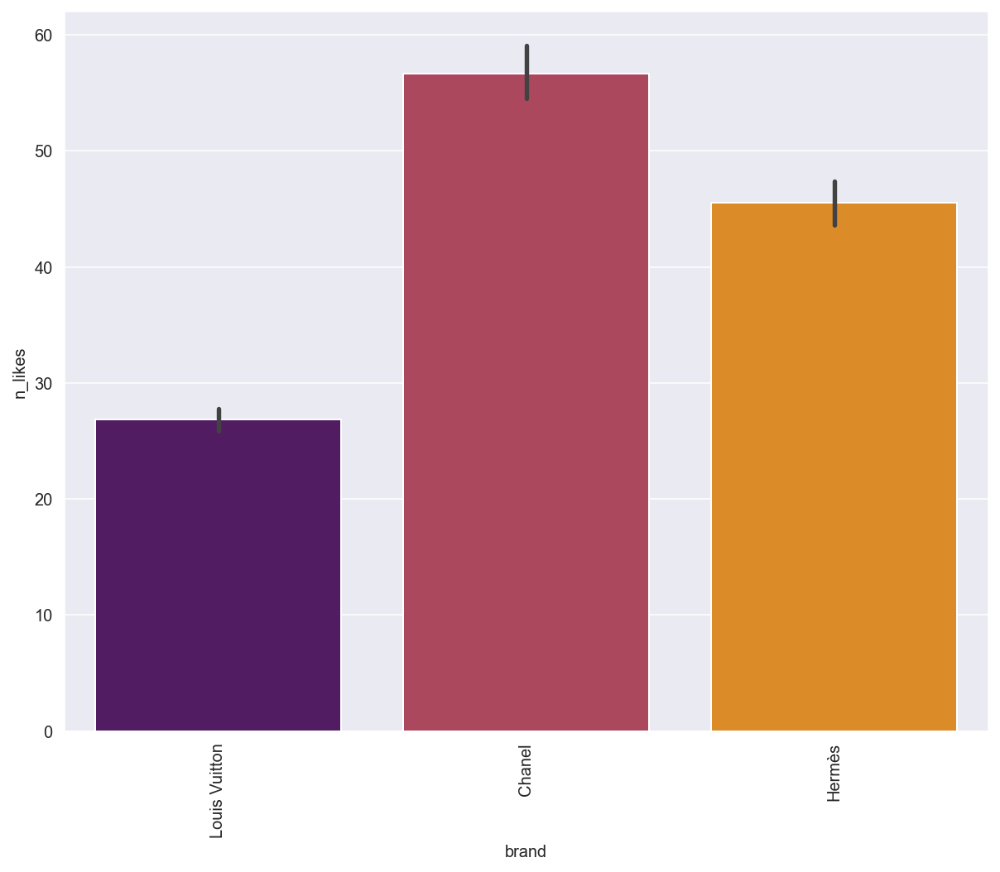

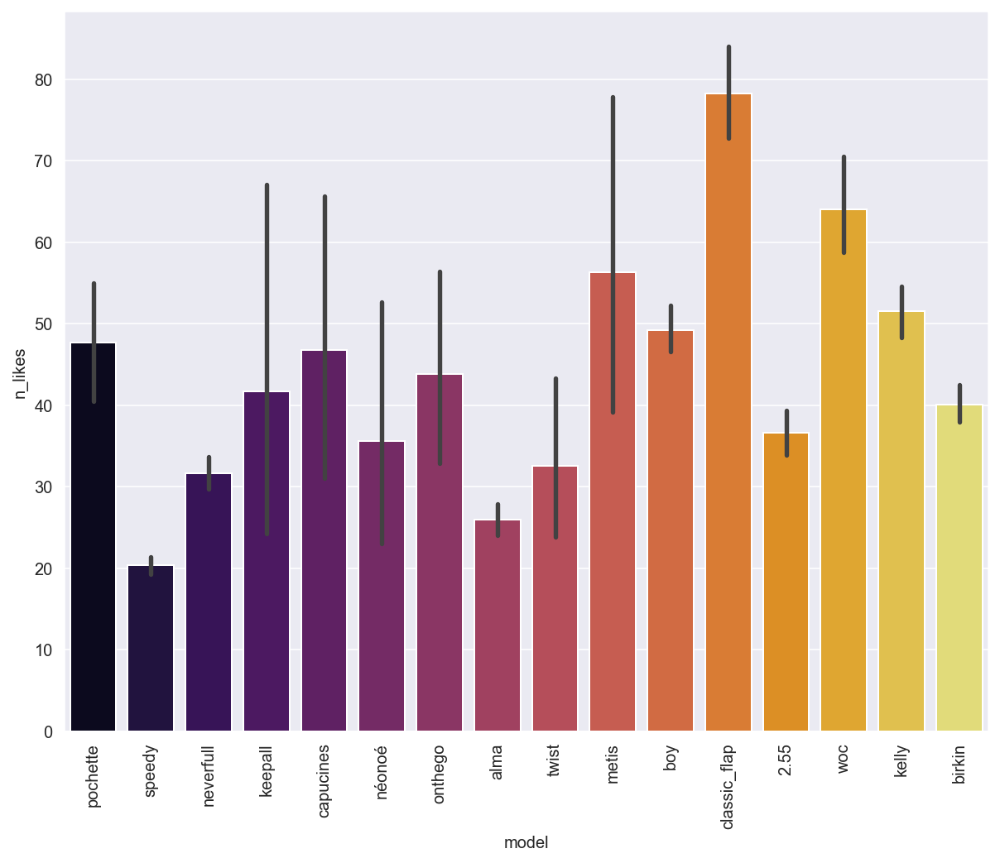

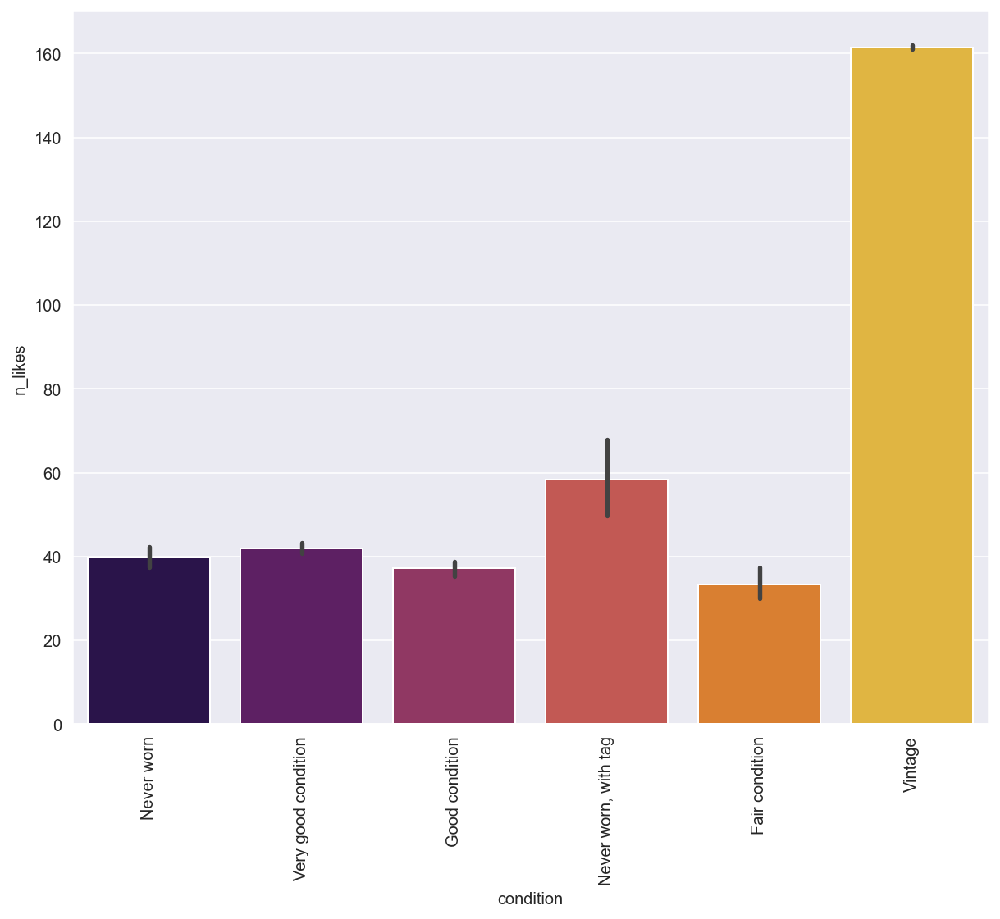

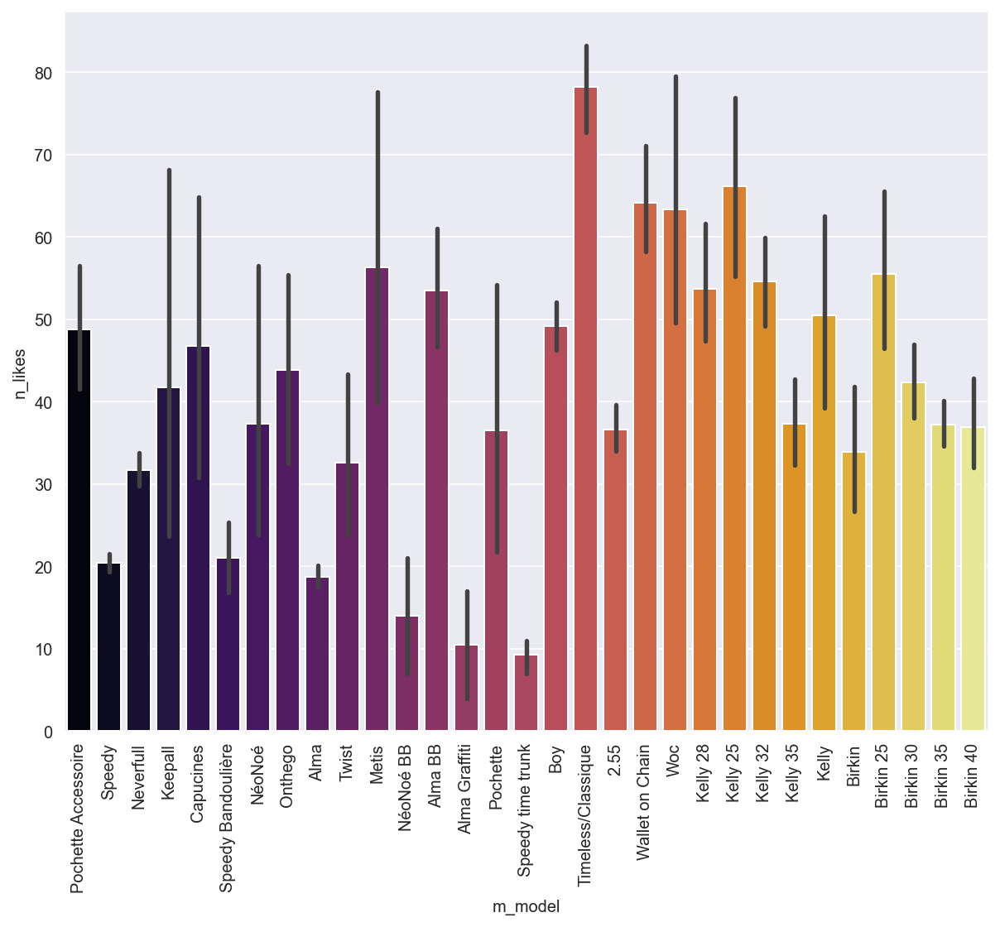

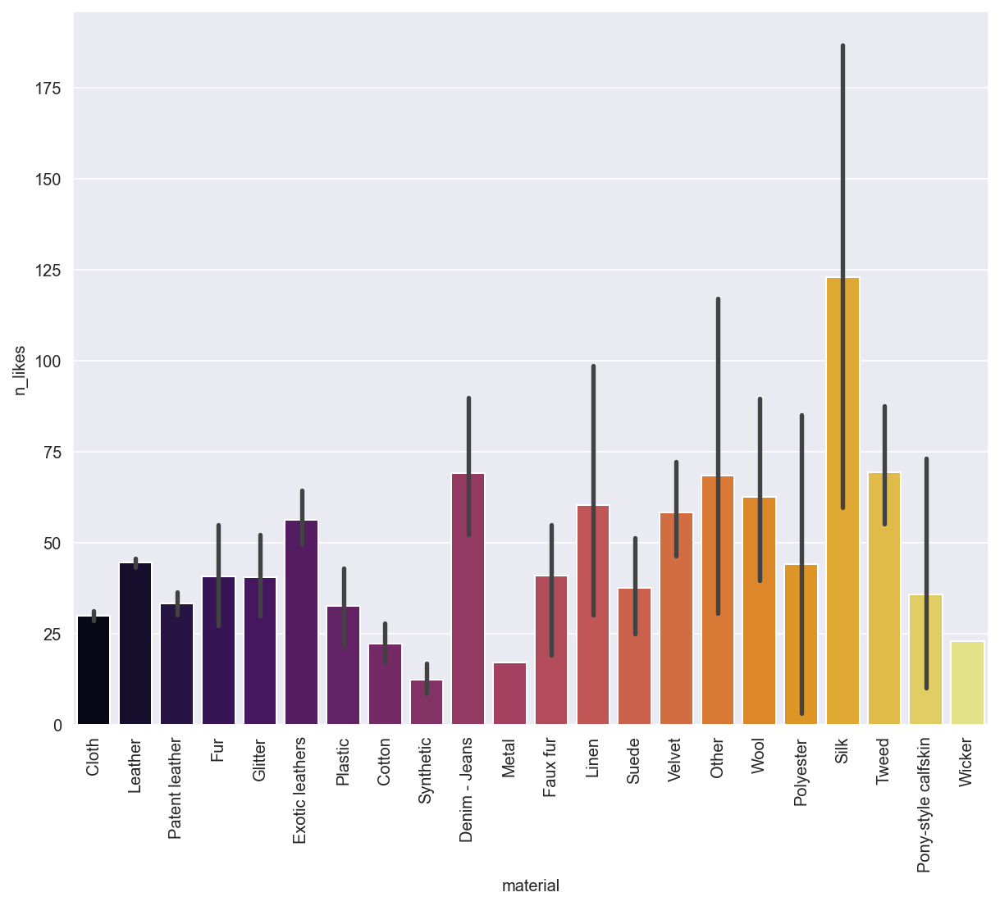

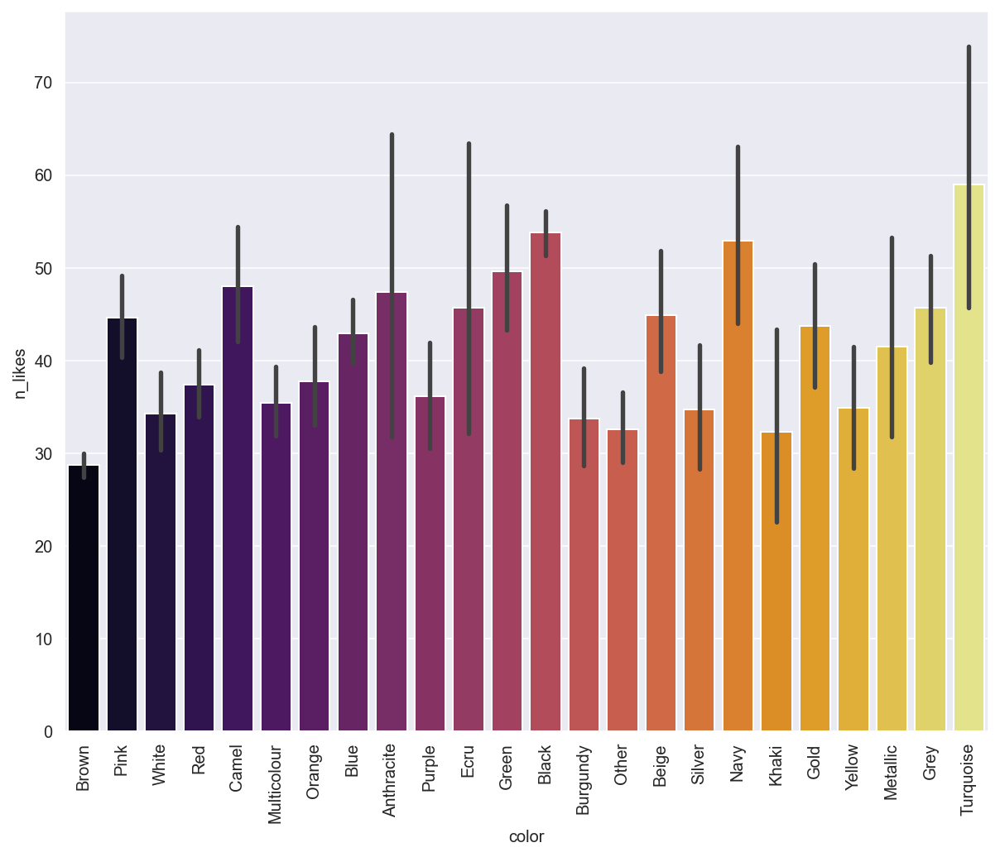

In [399]:
# Bar plotting favorable bags with categorical  features of handbags dataframe

for x in handbags.describe(include='object').columns:
    if x != 'description' and x != 'title':
        plt.figure(figsize= (10, 8))
        sns.barplot(x=handbags[x], y = handbags.n_likes, palette="inferno")
        plt.xticks(rotation=90)
        

In [400]:
#  Visualizing a net of Customers likes per each each datapoint and total number of model and brand 
df = handbags[[ 'brand', 'model', 'n_likes']]
fig = px.parallel_categories(df, color="n_likes", color_continuous_scale=px.colors.sequential.Inferno)
fig.show()                 

### Impact of the bag being limited edition

More than 1250 observations belongs to limited edition in Louis Vuitton brand. 

Capucines and keepall are standing out, but most of the models has a positive return  except twist, simple speedy and alma, marginal is pochette. Never worn and very good condition seems more valuable , along with unique materials and leather materials . Suede and exotic materials drop a lot in value. Profitable colors are Khaki, green, black, orange, whereas grey, camel, metallic doesn't make good returns.


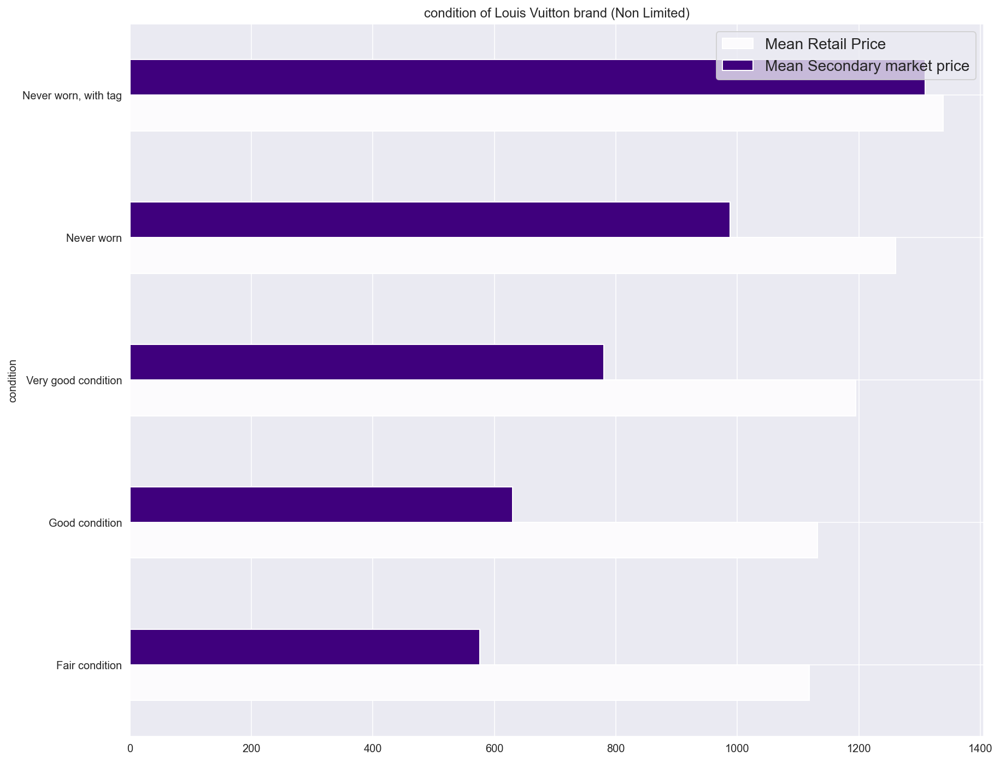

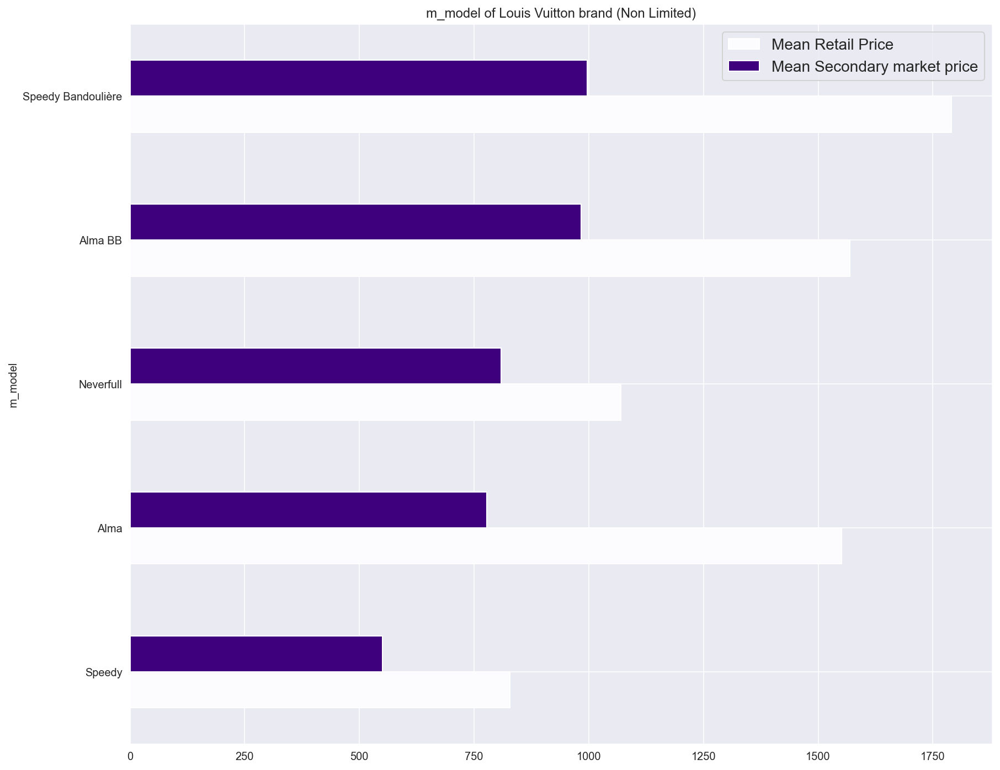

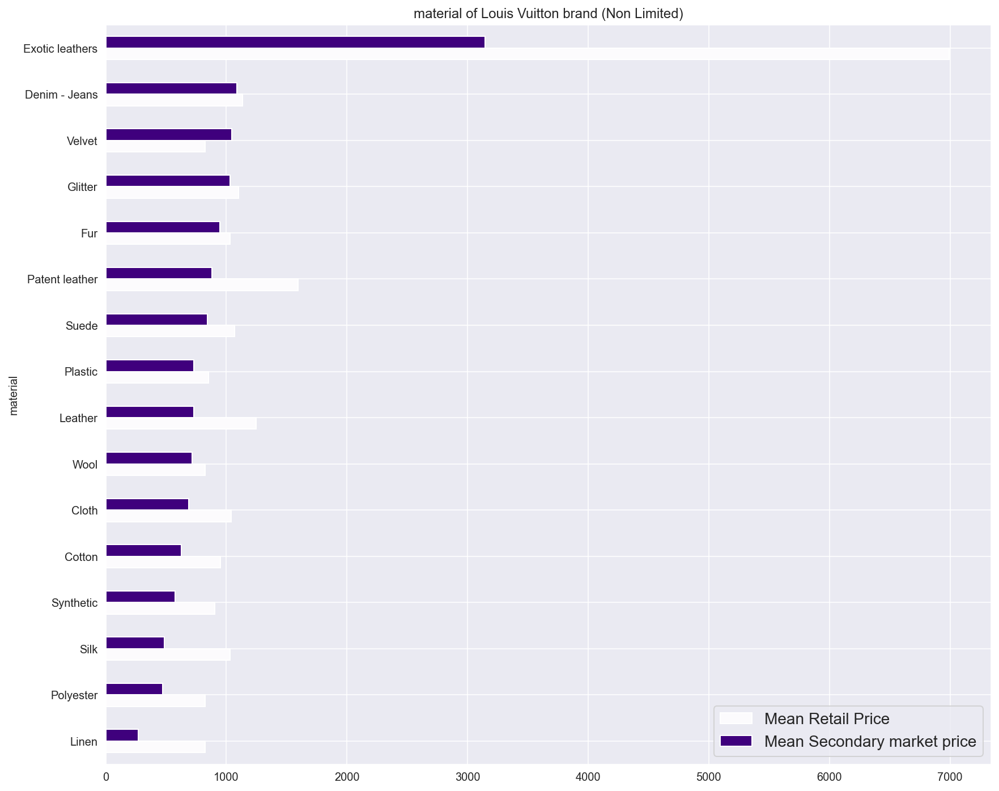

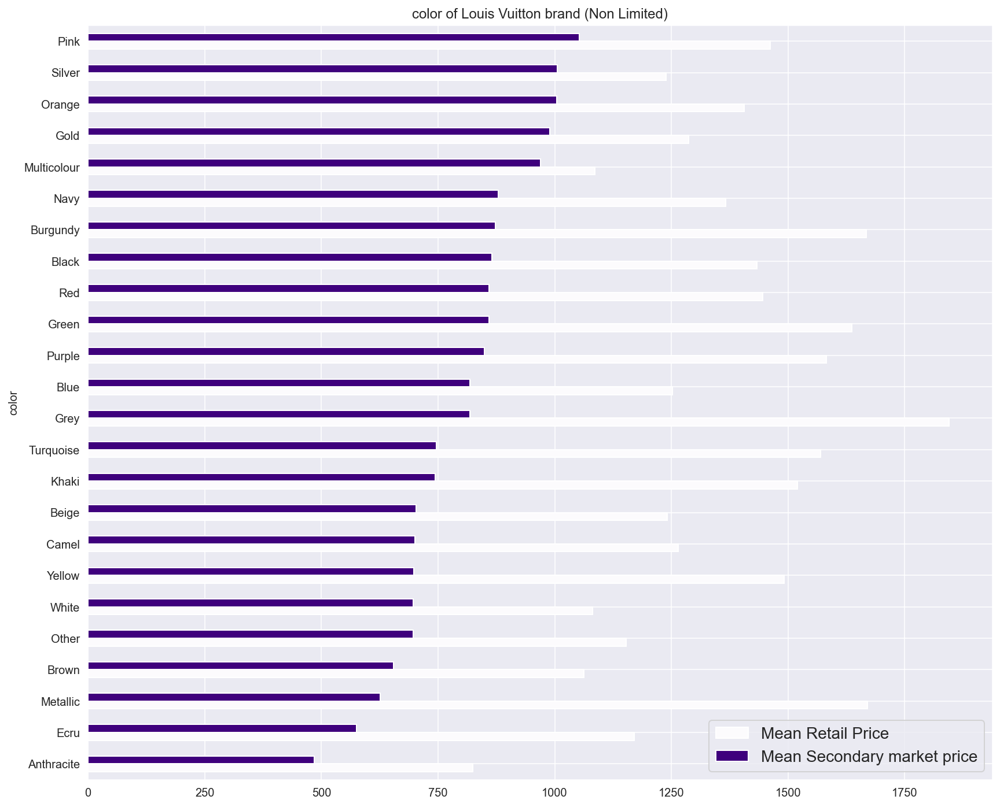

In [30]:
for x in handbags.describe(include='object').columns:
    if x != 'description' and x != 'title' and x != 'brand' and x != 'model':
        handbags[(handbags.brand == 'Louis Vuitton') & (handbags.limited == 0)].groupby([x])[["mean_retail_price", "final_resale_price"]] \
        .mean().sort_values(by='final_resale_price').plot(kind='barh', figsize=(14, 12), 
         title=x+" of Louis Vuitton brand (Non Limited)", cmap = 'Purples').legend(['Mean Retail Price', 'Mean Secondary market price'],
                                                                prop={'size': 14})
        

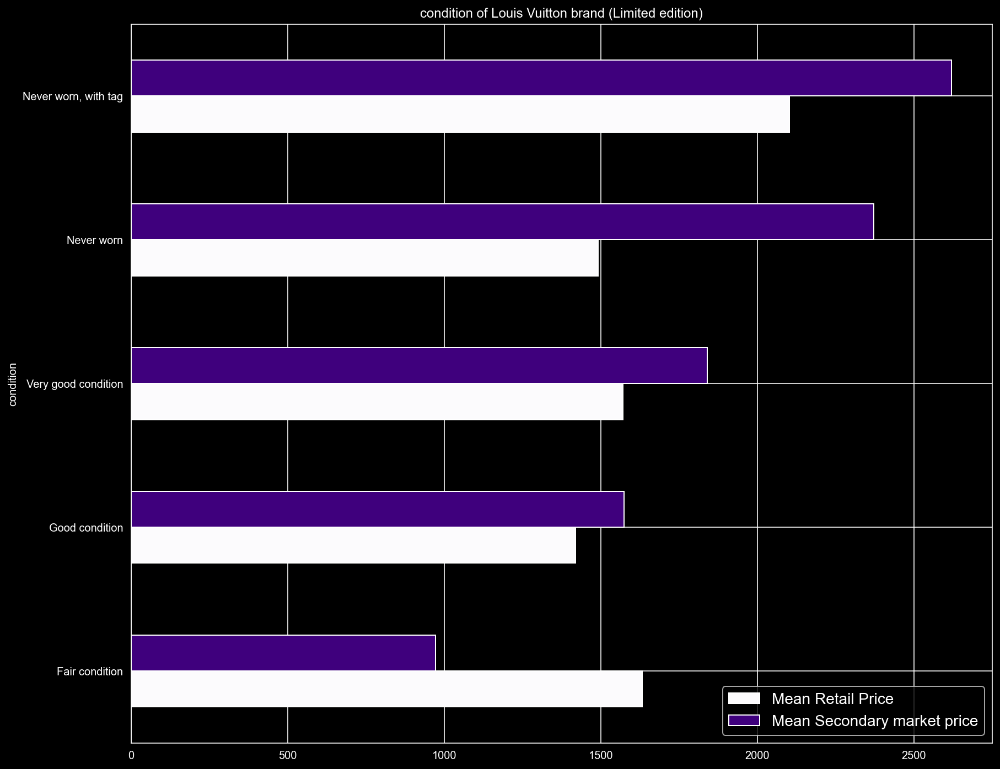

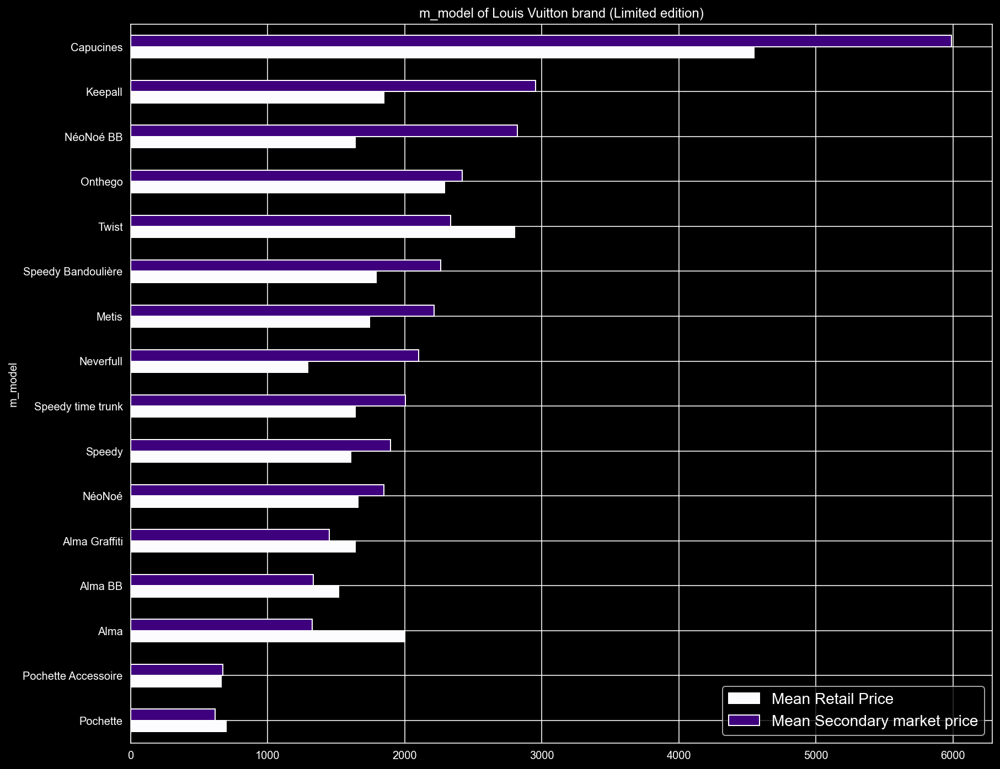

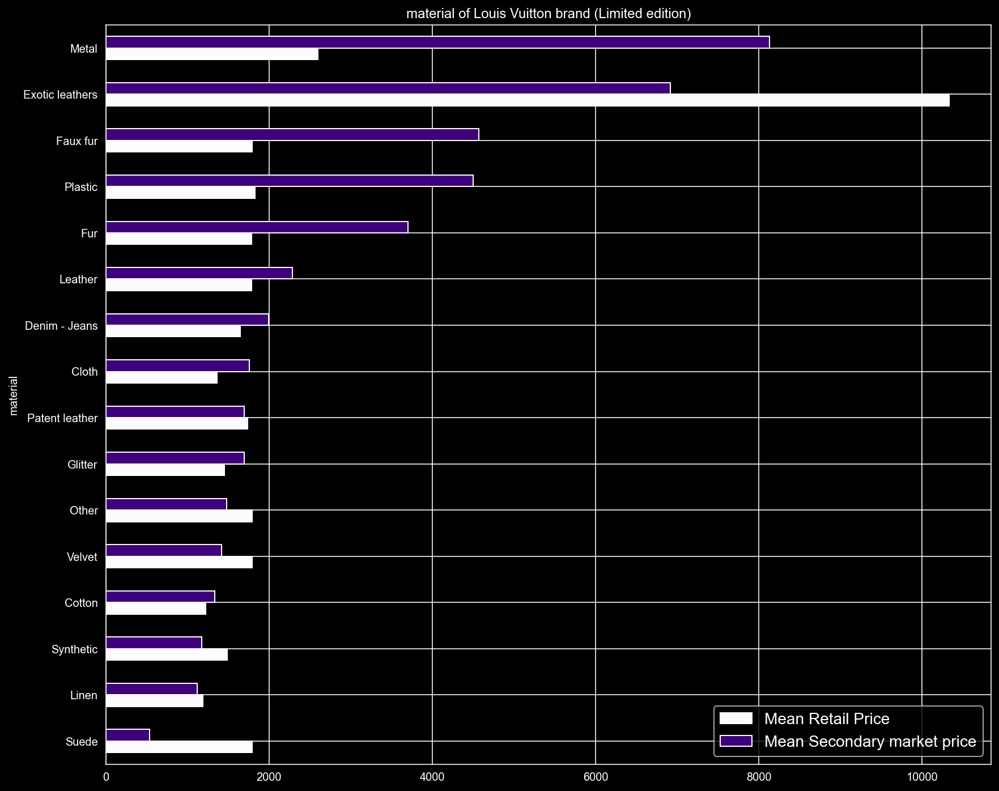

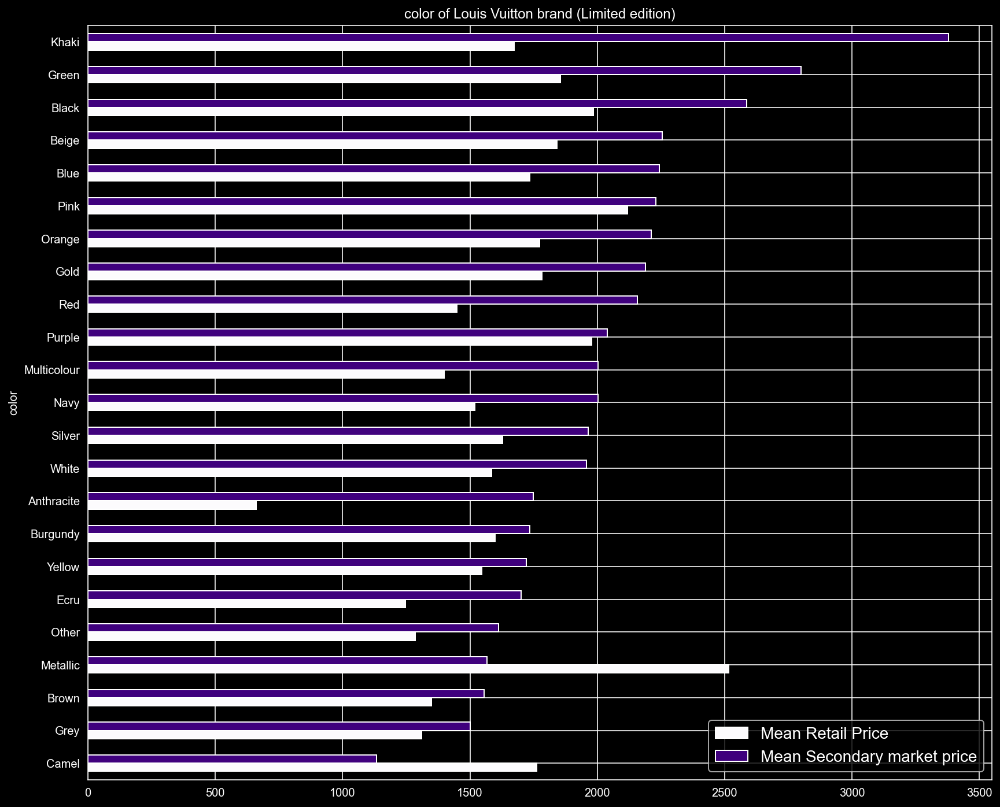

In [45]:
# Box plots of features vs being limited edition, which is only in Lv brand

plt.style.use("dark_background")

for x in handbags.describe(include='object').columns:
    if x != 'description' and x != 'title' and x != 'brand' and x != 'model':
        handbags[(handbags.brand == 'Louis Vuitton') & (handbags.limited == 1)].groupby([x])[["mean_retail_price", "final_resale_price"]] \
        .mean().sort_values(by='final_resale_price').plot(kind='barh', figsize=(14, 12), 
         title=x+" of Louis Vuitton brand (Limited edition)", cmap = 'Purples').legend(['Mean Retail Price', 'Mean Secondary market price'],
                                                                prop={'size': 14})
        



In [402]:
handbags.groupby(['brand', 'model'])[["mean_retail_price", "final_resale_price"]].mean()

mean_retail_price  final_resale_price
brand         model                                              
Chanel        2.55                5231.104816         3147.432550
              boy                 3368.754398         2984.931267
              classic_flap        5103.085847         3705.613179
              woc                 1490.000000         1510.834649
Hermès        birkin              9482.696384        12433.291708
              kelly               8740.860514         9891.350645
Louis Vuitton alma                1569.531603          844.360909
              capucines           4547.142857         5986.654286
              keepall             1850.000000         2953.054324
              metis               1742.000000         2216.117742
              neverfull           1124.271022         1121.197925
              néonoé              1658.571429         1916.185714
              onthego             2290.000000         2417.897742
              pochette             663.306011          666.408743
              speedy              1012.540246          833.231667
              twist               2800.000000         2334.684687

### Average Retail Price vs Secondary Market Price

The best way to generate return is to never use bag 
The higher resale values are generated by 'never warn' or 'never warn with tag'. 
In order to generate higher returns for resales it is in the buyers best interested minimally use the bags and keep the tags.

Clearly the resale value for exotic leathers are significantly higher than other materials. 
When comparing the difference between average retail across various materials with the average sale prices are generating higher return for Hermes brand. 

All three brands has good linear relationship between retail and resale price. Hermes and Louis Vuitton has good indicator of resale price to raise in value, and steeper line like Chanel has , means less increase but overall its very positive . 

In [96]:
# Scatter plot with violin and box plots of the brands , representing Final Resale Price vs Mean Retail Price
# Plotting the Ordinary least squares trends to display possible linear relationship between price features

fig = px.scatter(handbags, x="final_resale_price", y="mean_retail_price", color='brand', marginal_y="violin",
           marginal_x="box", trendline="ols", template="plotly_dark", 
                 labels={"final_resale_price": "Final Resale Price (£)",
                  "mean_retail_price": "Mean Retail Price (£)"},  color_discrete_map = {"one": "green", "two": "red", "three":"blue"})
fig.show()


In [97]:
# Visualize of each model category per Brand , comparing Final Resale Price to Mean Retail Price

for name in handbags.brand.unique():
    fig = px.scatter(handbags[handbags.brand == str(name)], x="final_resale_price", y="mean_retail_price", 
                     color='model', marginal_y="violin",marginal_x="box", trendline="ols", template="simple_white",
                     labels={"final_resale_price": "Final Resale Price (£)",
                  "mean_retail_price": "Mean Retail Price (£)"}, title = name+" Retail Price vs Resale Price")
    fig.show();

/Users/Ketevana/opt/anaconda3/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/Ketevana/opt/anaconda3/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/Ketevana/opt/anaconda3/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning:

divide by zero encountered in double_scalars



/Users/Ketevana/opt/anaconda3/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning:

divide by zero encountered in double_scalars



### Is there multi-collinearity present within the dataset?

Using pandas profiling we can see that brand is highly correlated with model, m_model and title (correlations > 0.90). It is clear there are high correlations present between the price variables. Price variable is highly correlated with mean_retail_price and discount_price (corr > 0.60). Mean_retail_price is highly correlated with brand, title, model and description (corr > 0.77), color and limited has good correlation as well (corr around 0.40)

Condition is negatively correlating mostly with all of the variables except limited, sold_out and n_likes.

Testing Lasso regularisation would be worthwhile to see if it negates the affects of any of the variables.

In [92]:
profile = pandas_profiling.ProfileReport(handbags)

# Display the output from pandas profiling:
profile

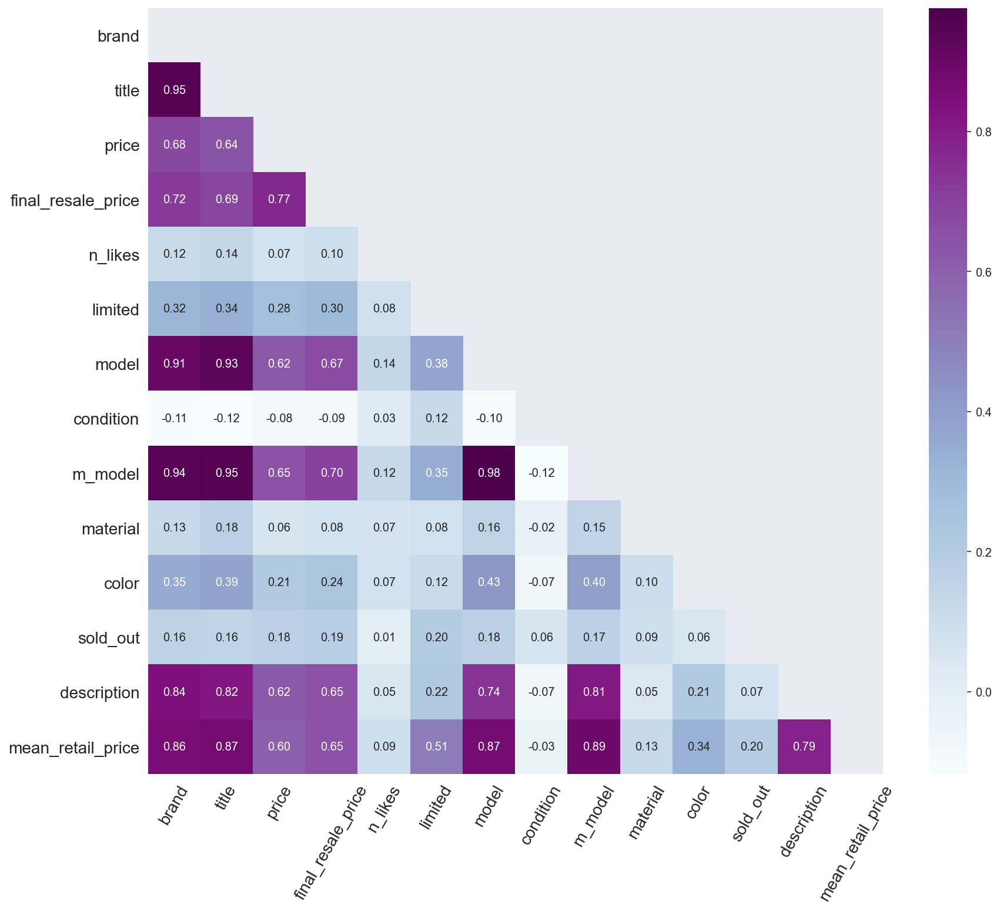

In [406]:
# Create dataframe factorizing all columns to 
df_corr = handbags.apply(lambda x: x.factorize()[0]).corr()
fig, ax = plt.subplots(figsize=(14, 12))

# Generate a mask for the upper triangle (taken from seaborn example gallery)
mask = np.zeros_like(df_corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Plot the heatmap with seaborn.
# Assign the matplotlib axis the function returns. This will let us resize the labels.
sns.heatmap(df_corr, mask=mask, annot=True, cmap= 'BuPu', ax=ax, fmt='.2f', annot_kws={'size':10})
ax.set_ylim([handbags.shape[1], 0])

ax.set_xticklabels(ax.xaxis.get_ticklabels(), fontsize=14, rotation=60)
ax.set_yticklabels(ax.yaxis.get_ticklabels(), fontsize=14)
plt.show()

In [434]:
fig = px.parallel_categories(handbags, color_continuous_scale=px.colors.sequential.Inferno, template="plotly_dark")
fig.show()

In [84]:
#  Visualisation of connection (net) of grouped observations between categorical features regarding Mean Retail Price

df = handbags[['brand','limited', 'm_model', 'material','sold_out', 'mean_retail_price']]
fig = px.parallel_categories(df, color="mean_retail_price", color_continuous_scale=px.colors.sequential.Inferno, 
                             template="plotly_dark")
fig.show()

In [83]:
# Visualizing connections between different features across handbags

fig = px.parallel_coordinates(handbags,  color="mean_retail_price", labels={"price": "Secondary Market Price (£)",
                  "final_resale_price": "Final Resale Price (£)", "n_likes": "Number of Likes ❤️",
                  "limited": "Limited (binary)", "sold_out": "Sold (👍/👎)", "mean_retail_price": "Mean Retail Price (£)"},
                    color_continuous_scale=px.colors.diverging.Tealrose, color_continuous_midpoint=2, template="plotly_dark")
fig.show()

In [90]:
# Scatter plot of each data point(Assigned as certain model category), comparing Resale Price to Mean Retail Price
# with closer look to the items with Resale price under £20,000

fig = px.scatter(handbags.query("price<20000"), x="price", y="mean_retail_price", size="mean_retail_price", color="brand",
           hover_name="m_model", log_x=True, size_max=60, color_continuous_scale=px.colors.sequential.Inferno,  color_discrete_map = {"one": "green", "two": "red", "three":"blue"}
                 , template="plotly_dark")

fig.show()

In [91]:
# 3D visualization of Mean Retail price vs Resale price and Final Resale price between 3 main brands 

fig = px.scatter_3d(handbags, x="price", y="final_resale_price", z="mean_retail_price", color="brand", 
                    size="mean_retail_price", hover_name="m_model", symbol="m_model", color_discrete_map = {"one": "green", "two": "red", "three":"blue"},
                    template="plotly_dark", labels={"price": "Secondary Market Price (£)", 
                    "final_resale_price": "Final Resale Price (£)", "mean_retail_price": "Mean Retail Price (£)"})
                           
fig.show()

In [439]:
grouped_by_features = handbags.groupby(['brand', 'm_model', 'material', 'color'])['price'].agg({'mean', 'max', 'min'}).reset_index()
grouped_by_features
# [::-1][:60] .size().unstack()

,brand,m_model,material,color,min,max,mean
0,Chanel,2.55,Cloth,Anthracite,2591.30,2591.30,2591.300000
1,Chanel,2.55,Cloth,Black,2034.61,4467.75,3159.902500
2,Chanel,2.55,Cloth,Blue,2299.00,4467.75,3506.553333
3,Chanel,2.55,Cloth,Burgundy,3484.85,3484.85,3484.850000
4,Chanel,2.55,Cloth,Gold,6701.63,6701.63,6701.630000
...,...,...,...,...,...,...,...
1081,Louis Vuitton,Twist,Leather,Blue,1340.33,4020.98,2503.772500
1082,Louis Vuitton,Twist,Leather,Gold,2010.49,2010.49,2010.490000
1083,Louis Vuitton,Twist,Leather,Multicolour,1340.33,2895.00,2117.665000
1084,Louis Vuitton,Twist,Leather,Navy,2233.88,2233.88,2233.880000


In [54]:
def return_resale_price(df, brand, model, material, color):
    """ 
    Function: takes a dataframe and categorical features, then generates the name of the bag, 
    it's approximate evaluation at current time and it gives a price range with minimum and maximum values
    based on the criteria’s for this exact bag.
    """
    choice = df.loc[(df.brand == brand) 
                          & (df.m_model == model)
                          & (df.material == material)
                          & (df.color == color)]['price'].values.mean()
    
    min_value = df.loc[(df.brand == brand) 
                          & (df.m_model == model)
                          & (df.material == material)]['final_resale_price'].min()
    
    max_value = df.loc[(df.brand == brand) 
                          & (df.m_model == model)
                          & (df.material == material)]['price'].max()
    
    title = df.loc[(df.brand == brand) 
                          & (df.m_model == model)
                          & (df.material == material) & (df.price == max_value)]['title'].values[0]
        
    
    return print('The Price Range for {}:'
                 '\n--------------------------\nFrom: £{} \tTo: £{}'
                 '\n--------------------------\n\t\t\t\t\t\t\t -----\n' 
                 'The Recommended Price for your Handbag is approximately: £{}'
                 '\n\t\t\t\t\t\t\t -----'
                 .format(title, round(min_value), round(max_value), round(choice)))
               



return_resale_prices(handbags, 'Chanel', '2.55', 'Cloth', 'Black')

The Price Range for 2.55 cloth handbag:
--------------------------
From: £1872 	To: £6702
--------------------------
							 -----
The Recommended Price for your Handbag is approximately: £3160
							 -----


In [57]:
from nltk.corpus import stopwords

In [58]:
stop = stopwords.words('english')

subset = handbags.description.dropna()
subset

7335     CHANEL - Classic Flap Bag - Jumbo - Black - Sh...
7336                               Chanel classic flap bag
7337     CHANEL Classic Flap Bag - Jumbo - Patent Exter...
7338     CHANEL Classic Flap Bag - Maxi Exterior  Black...
7339     CHANEL Classic Flap Bag - Mini Rectangular Ext...
                               ...                        
12769    HERMES BIRKIN 35 EPSOM NORTH BLUE GHDW. New ne...
12770    Incredible limited edition Birkin 35 bicolor b...
12771    Hermès Birkin 25 geranium color, togo leather,...
12772    Bag in good general condition missing the padl...
12773    never worn /  jamais porté.\nPackaging: Origin...
Name: description, Length: 5122, dtype: object

In [59]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

cvec = TfidfVectorizer(analyzer='word',
                       stop_words=stop,
                       strip_accents='unicode',
                       lowercase=True,
                       max_features=10000,
                       ngram_range=(1, 3))
cvec.fit(subset)
document_matrix = cvec.transform(subset)
document_matrix

<5122x10000 sparse matrix of type '<class 'numpy.float64'>'
	with 288126 stored elements in Compressed Sparse Row format>

In [60]:
df=pd.DataFrame(document_matrix.todense(),columns=cvec.get_feature_names())

z = document_matrix.sum(axis=0)
important_words = pd.DataFrame(z.ravel(), columns=cvec.get_feature_names())

In [12]:
c=important_words.T.sort_values(by = 0, ascending=False)[:20]
c

,0
bag,221.127814
leather,162.499154
box,160.945233
condition,158.592854
hermes,149.107708
dustbag,140.835745
chanel,136.853496
packaging,121.041915
birkin,121.036550
original,119.877704


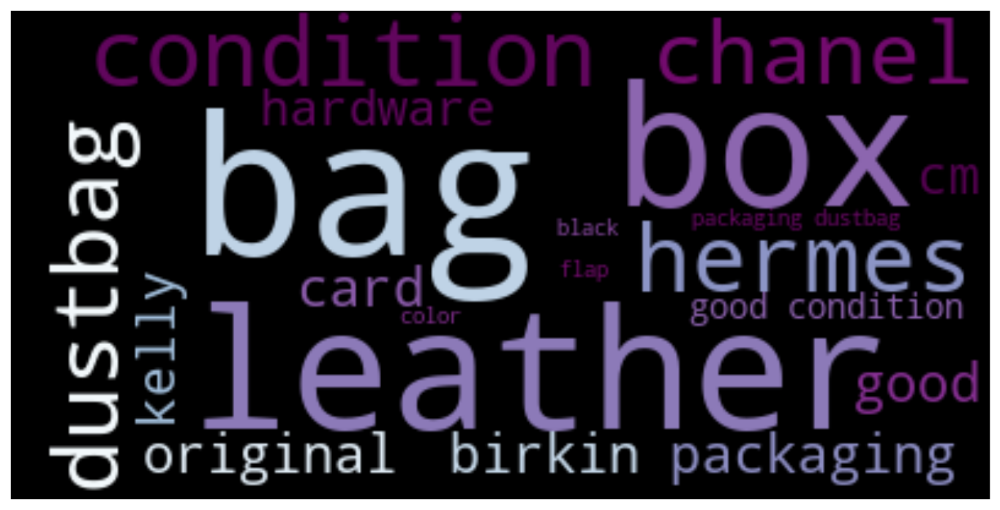

In [13]:
from wordcloud import WordCloud


wc_gen = {}
wc = WordCloud(mode='RGBA',colormap='BuPu',random_state=2)

fig, ax = plt.subplots(figsize=(12,40))


wc_gen = wc.generate_from_frequencies(dict(c.reset_index().values))
ax.imshow(wc_gen,interpolation='bilinear')
ax.set_xticks([])
ax.set_yticks([])
    
plt.show()